### 최종 베일리 규준 원점수에 따른 환산점수 프레임으로 전처리

In [1]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx')
print(df)
sheet_name = pd.ExcelFile('최종_규준(환산).xlsx')
print(sheet_name.sheet_names)

    scaled score 0:16-0:25 0:26-1:05 1:06-1:15 1:16-1:25 1:26-2:05 2:06-2:15  \
0              1         -         -         -         -         0       0-1   
1              2         -         -         0       0-1       1-2       2-3   
2              3         -         0         1         2       3-4       4-5   
3              4         0       1-2         2       3-4         5       6-7   
4              5         1         3       3-4       5-6       6-7       8-9   
5              6         2         4         5       7-8       8-9     10-11   
6              7       3-4         5         6         9     10-11     12-14   
7              8       5-6         6         7        10        12        15   
8              9         7       7-8       8-9        11        13        16   
9             10       8-9         9     10-11        12     14-15        17   
10            11        10        10        12        13     16-17        18   
11            12        11        11    

In [2]:
# 인지(KCG) 먼저 진행하고 함수화하여 일괄 진행
recog = df
print(recog.columns)

Index(['scaled score', '0:16-0:25', '0:26-1:05', '1:06-1:15', '1:16-1:25',
       '1:26-2:05', '2:06-2:15', '2:16-2:25', '2:26-3:05', '3:06-3:15',
       '3:16-3:25', '3:26-4:05', '4:06-4:15', '4:16-4:25', '4:26-5:05',
       '5:06-5:15', '5:16-6:15', '6:16-7:15', '7:16-8:15', '8:16-9:15',
       '9:16-10:15', '10:16-11:15', '11:16-12:15', '12:16-13:15',
       '13:16-14:15', '14:16-15:15', '15:16-16:15', '16:16-17:15',
       '17:16-18:15', '18:16-19:15', '19:16-20:15', '20:16-21:15',
       '21:16-22:15', '22:16-23:15', '23:16-24:15', '24:16-25:15',
       '25:16-26:15', '26:15-27:16', '27:16-28:15', '28:16-29:15',
       '29:16-30:15', '30:16-31:15', '31:16-32:15', '32:16-33:15',
       '33:16-34:15', '34:16-35:15', '35:16-36:15', '36:16-39:15',
       '39:16-42:30'],
      dtype='object')


In [3]:
# scaled score와 특정 연령 분리하여 df화
def df_temp_gen(df, select_age) :
    df_temp = df.loc[:, ['scaled score', select_age]]
    return df_temp

In [4]:
df_temp = df_temp_gen(recog, '0:16-0:25')
print(df_temp)

    scaled score 0:16-0:25
0              1         -
1              2         -
2              3         -
3              4         0
4              5         1
5              6         2
6              7       3-4
7              8       5-6
8              9         7
9             10       8-9
10            11        10
11            12        11
12            13        12
13            14        13
14            15     14-15
15            16     16-18
16            17     19-21
17            18     22-24
18            19    25-162


In [5]:
# 값이 문자열로 되어 있는거 같음 -> min, max 바로 적용이 안됨
# 시리즈로 변환 후 '-' 텍스트 제거하고
# '-' 텍스트가 있으면 범위 산정해서 리스트화 하고
# 모든 리스트 합쳐서 범위를 산정해야할까???
# 생각해보니 원점수 범위는 동일한거 아닌가? -> 척도별로 원점수 범위가 다르기 때문에 자동화하려면 함수 개발이 필요함
def raw_range(df_temp) :
    meta_list = []
    for i in range(len(df_temp)) :
        num = df_temp.iloc[:,1][i]
        temp_list = []
        print(num)
        if num == "-" :
            pass
        else :
            try :
                int(num)
                num = int(num)
                temp_list.append(num)
            except ValueError :
                start_str, end_str = num.split("-")
                start = int(start_str)
                end = int(end_str)
                temp_list = list(range(start, end+1))
        meta_list.extend(temp_list)
    return meta_list

In [6]:
# meta_list가 키값이 되고
# 그 다음 열부터 해당 연령의 매칭되는 환산점수가 되도록 전처리 함수
def scale_score_df(df, raw_min=None, raw_max=None) :
    merged_df = None
    age_list = df.columns[1:]

    for age_col in age_list : # 특정 연령 리스트를 컬럼명으로 인자 설정

        df_temp = df_temp_gen(df, age_col) # 특정 연령 df_temp 추출

        if raw_min is None and raw_max is None :
            raw_list = raw_range(df_temp) # 특정 연령에서의 원점수 범위 raw_list 산출
        else :
            raw_list = list(range(raw_min, raw_max + 1))  # 고정 범위 생성
        
        scaled_score_list = [] # 환산점수 빈 리스트 생성
        for idx in range(len(df_temp)) : # 특정 연령 df(환산점수, 원점수 범위)의 행 갯수로 idx 지정
            scaled_score = df_temp.iloc[:,0][idx] # idx에 해당하는 환산점수
            raw_text = df_temp.iloc[:,1][idx] # idx에 해당하는 원점수 범위
            if raw_text == "-" :
                print('pass', raw_text)
                pass
            else :
                try :
                    print('try', raw_text)
                    raw = int(raw_text) # 원점수 범위가 아니라 하나일 경우 정수 변환
                    scaled_score_list.append(scaled_score) # 환산점수 리스트에 붙이고
                except ValueError :
                    print('error', raw_text)
                    start_text, end_text = raw_text.split("-") # 원점수 범위인 경우 텍스트 분리하고
                    start, end = map(int, [start_text, end_text]) # 각 각 정수 변환
                    for scale in range(start, end+1) : # 범위 길이를 횟수로 지정
                        scaled_score_list.append(scaled_score) # 범위 길이만큼 for반복해 idx에 해당하는 환산점수 반복하여 리스트에 붙이고
                        #print(scaled_score_list)
        print('+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++')
        print(len(raw_list), raw_list)
        print(len(scaled_score_list), scaled_score_list)
        if len(raw_list) == len(scaled_score_list) :
            age_norm_df = pd.DataFrame({'raw' : raw_list, f'{age_col}' : scaled_score_list})
        else :
            diff = len(raw_list) - len(scaled_score_list)
            if diff > 0 :
                scaled_score_list.extend([None] * diff)
                age_norm_df = pd.DataFrame({'raw': raw_list, f'{age_col}': scaled_score_list})
            else :
                print('길이 오류')
        print(age_norm_df)
        if merged_df is None :
            merged_df = age_norm_df # 첫번째 생성된 age_norm_df(원점수, 환산점수)를 merged_df로 정의
        else :
            merged_df = merged_df.merge(age_norm_df, on='raw', how='left') # 첫번째 생성된 age_norm_df의 원점수 기준으로 병합
    return merged_df

In [7]:
result_df = scale_score_df(recog, raw_min=None, raw_max=None)

-
-
-
0
1
2
3-4
5-6
7
8-9
10
11
12
13
14-15
16-18
19-21
22-24
25-162
pass -
pass -
pass -
try 0
try 1
try 2
try 3-4
error 3-4
try 5-6
error 5-6
try 7
try 8-9
error 8-9
try 10
try 11
try 12
try 13
try 14-15
error 14-15
try 16-18
error 16-18
try 19-21
error 19-21
try 22-24
error 22-24
try 25-162
error 25-162
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
163 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 1

In [8]:
result_df

,raw,0:16-0:25,0:26-1:05,1:06-1:15,1:16-1:25,1:26-2:05,2:06-2:15,2:16-2:25,2:26-3:05,3:06-3:15,...,28:16-29:15,29:16-30:15,30:16-31:15,31:16-32:15,32:16-33:15,33:16-34:15,34:16-35:15,35:16-36:15,36:16-39:15,39:16-42:30
0,0,4,3,2,2,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,1,5,4,3,2,2,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
2,2,6,4,4,3,2,2,1,1,1,...,1,1,1,1,1,1,1,1,1,1
3,3,7,5,5,4,3,2,2,1,1,...,1,1,1,1,1,1,1,1,1,1
4,4,7,6,5,4,3,3,2,1,1,...,1,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
158,158,19,19,19,19,19,19,19,19,19,...,19,19,19,19,18,17,17,16,16,15
159,159,19,19,19,19,19,19,19,19,19,...,19,19,19,19,18,18,17,17,16,15
160,160,19,19,19,19,19,19,19,19,19,...,19,19,19,19,19,18,18,17,17,16
161,161,19,19,19,19,19,19,19,19,19,...,19,19,19,19,19,19,18,18,17,16


In [9]:
# 윈도우 한글 폰트 설정
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm

# 한글 폰트 설정 (Windows의 경우 'Malgun Gothic' 사용 권장)
plt.rcParams['font.family'] = 'Malgun Gothic'

# 마이너스 깨짐 방지
plt.rcParams['axes.unicode_minus'] = False

### 인지 규준 시각화

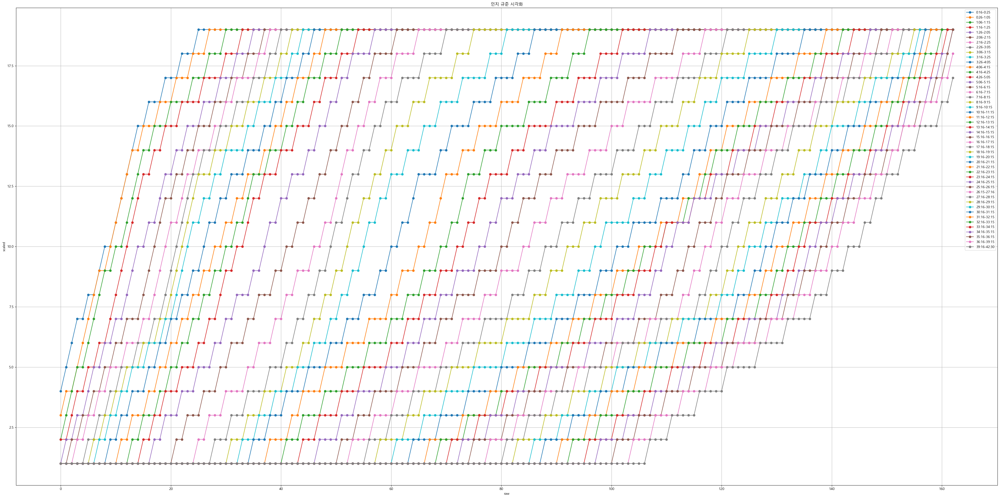

In [10]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('인지 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

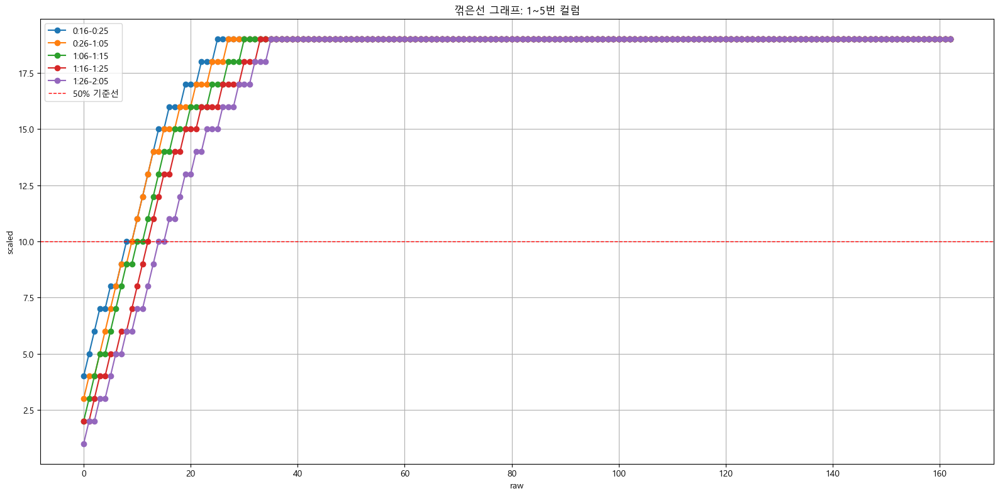

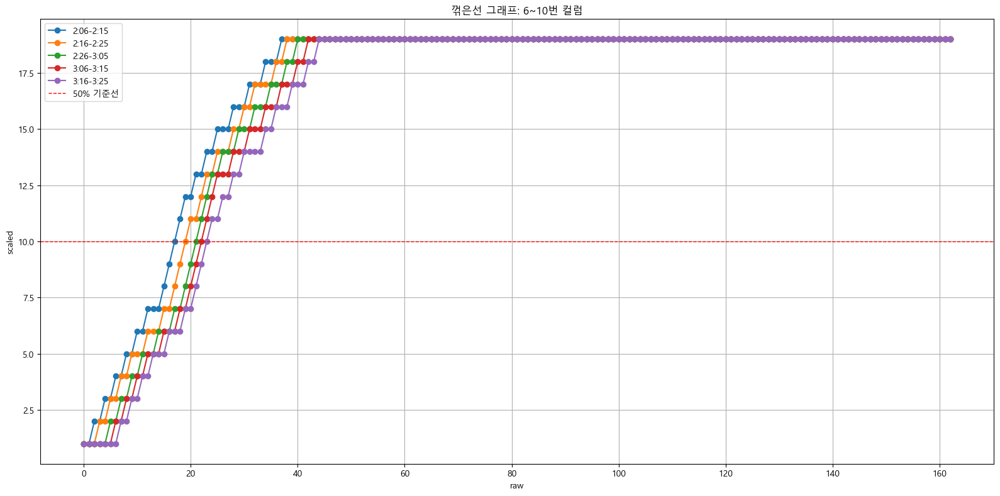

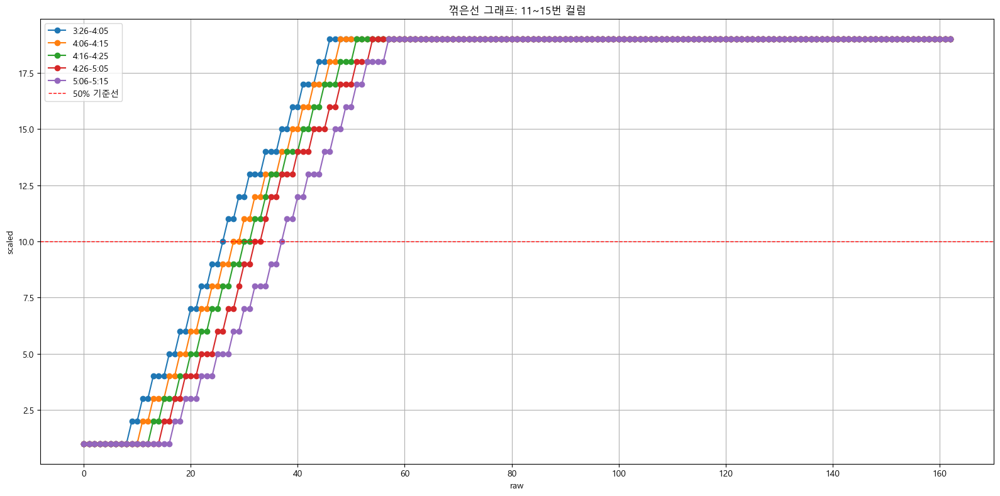

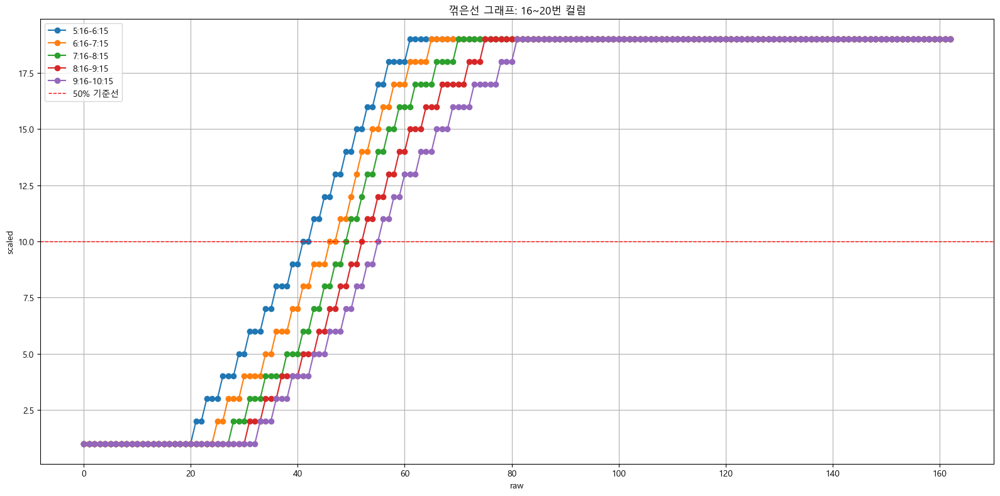

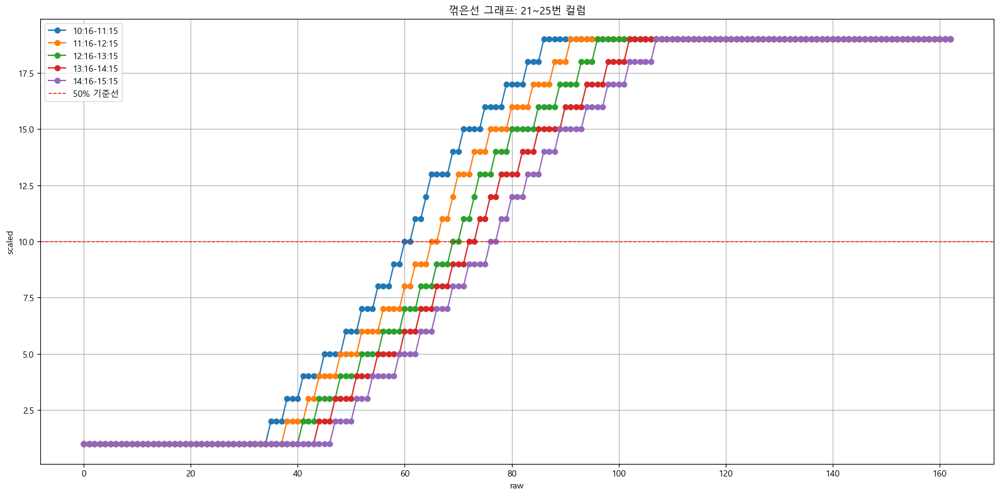

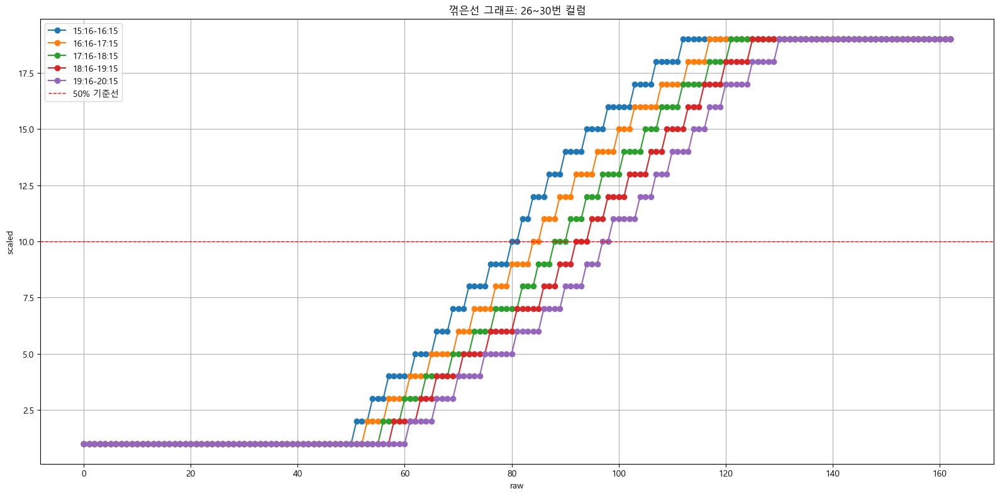

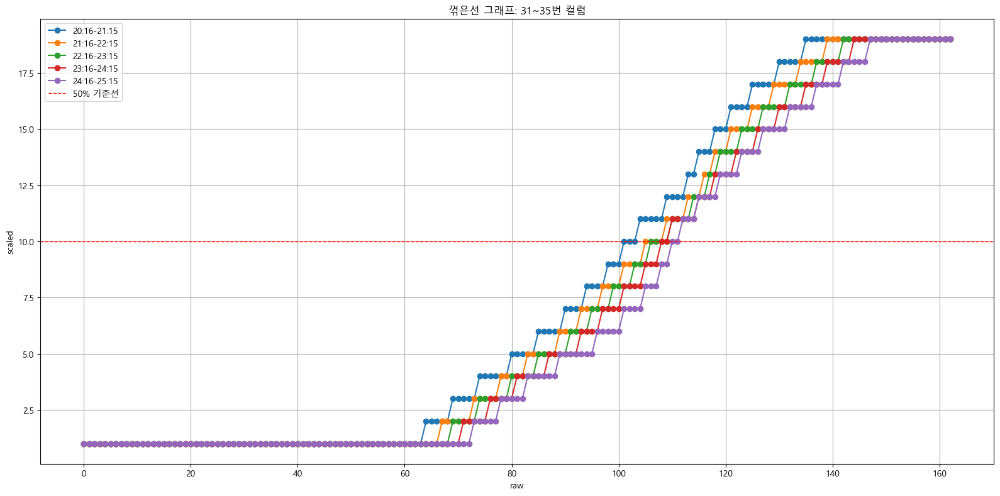

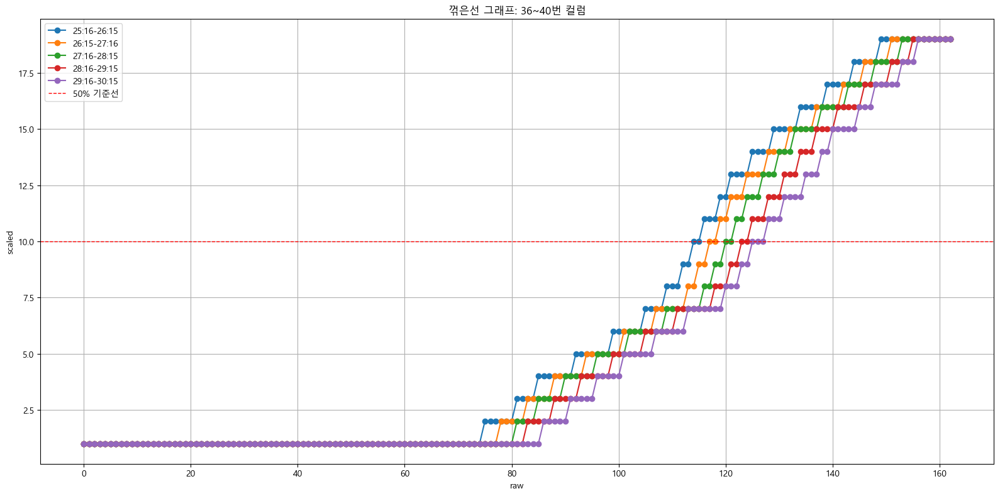

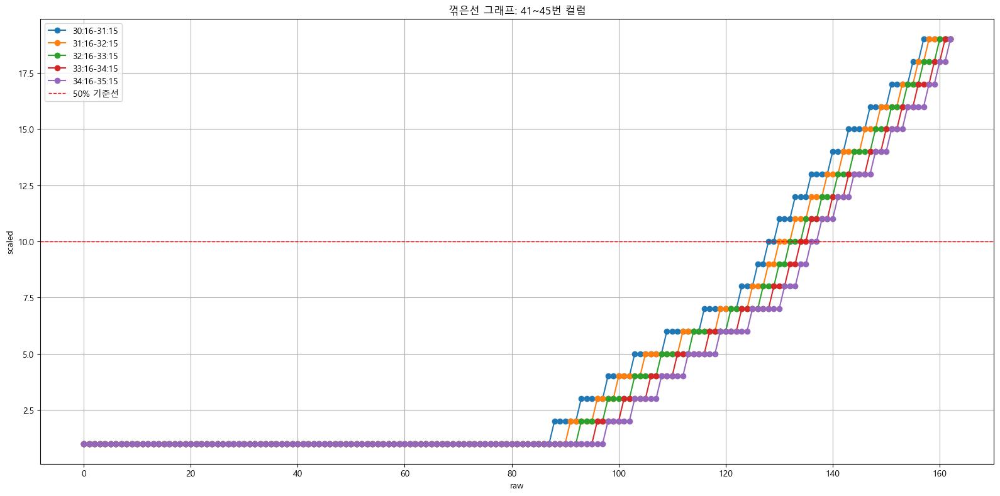

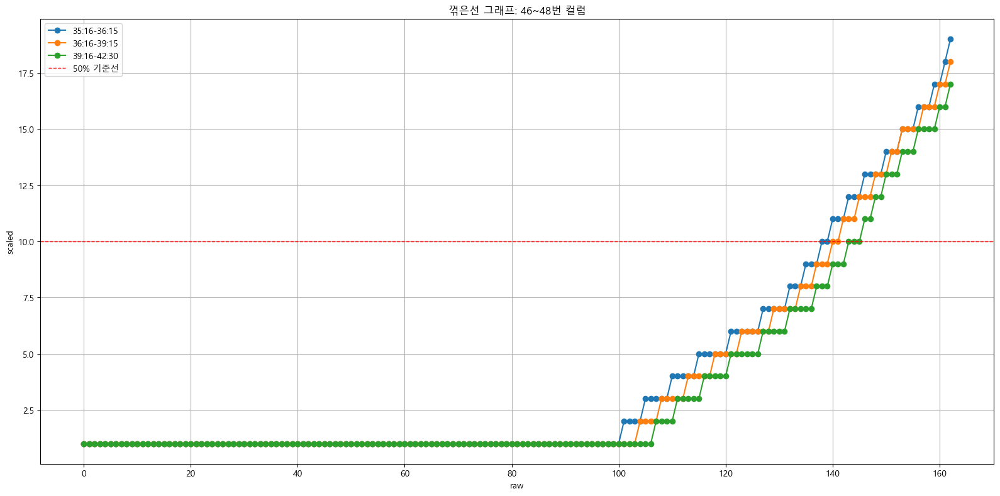

In [11]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 수용언어 시각화

In [12]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='수용언어(KRC)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:16-0:25 0:26-1:05 1:06-1:15 1:16-1:25 1:26-2:05 2:06-2:15  \
0              1         -         -         -         -         0       0-1   
1              2         -         0         0         0         1         2   
2              3         0         1         1         1         2         3   
3              4         1         2         2       2-3       3-4       4-5   
4              5         2         3       3-4         4         5         6   
5              6         3         4         5       5-6       6-7       7-8   
6              7         4         5         6         7         8         9   
7              8         5         6         7         8         9        10   
8              9         6         7         8         9        10        11   
9             10         7         8         9        10     11-12        12   
10            11         8         9        10        11        13        13   
11            12         9        10    

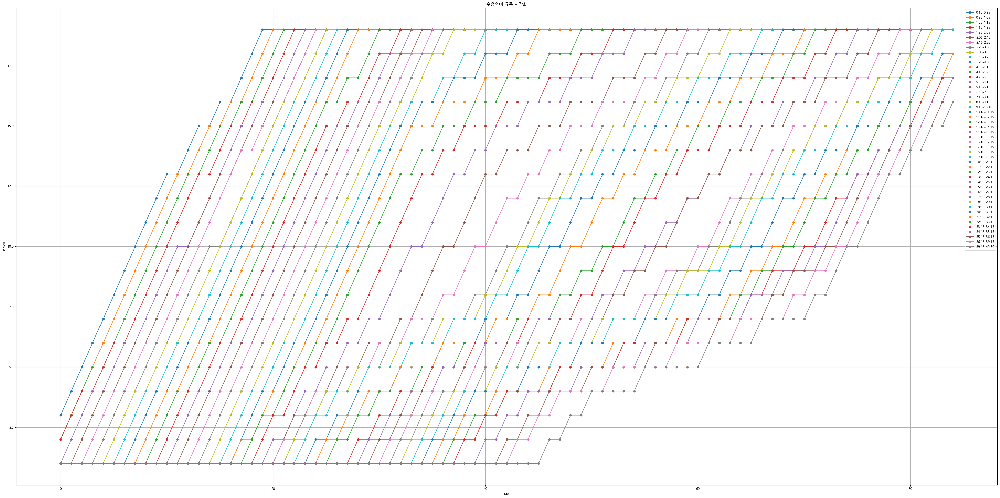

In [13]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

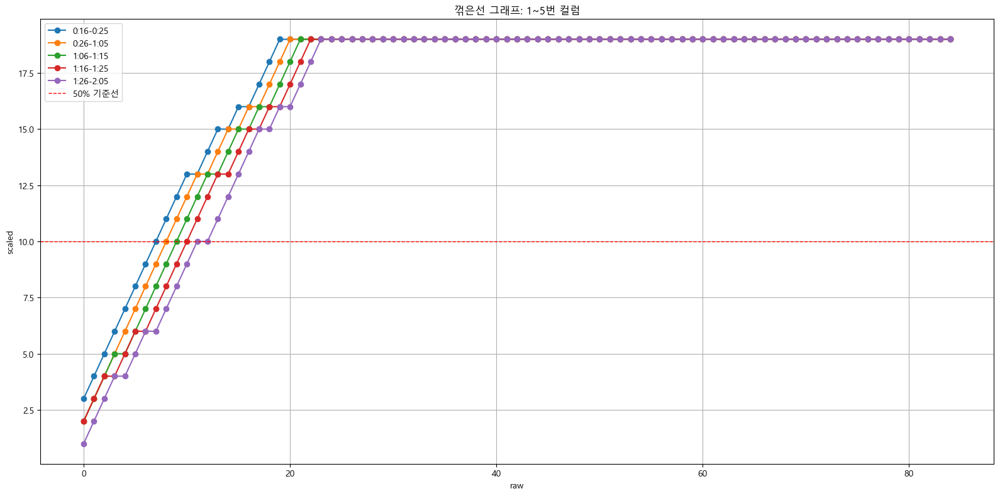

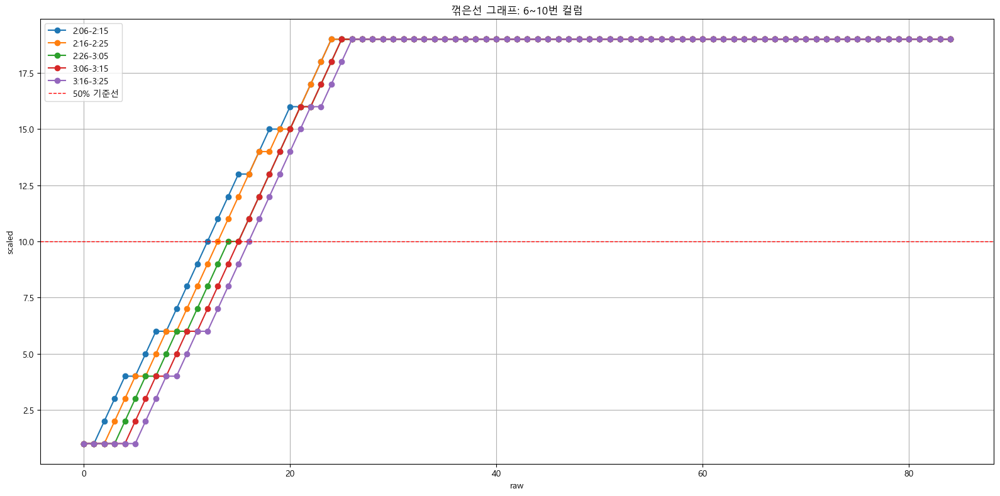

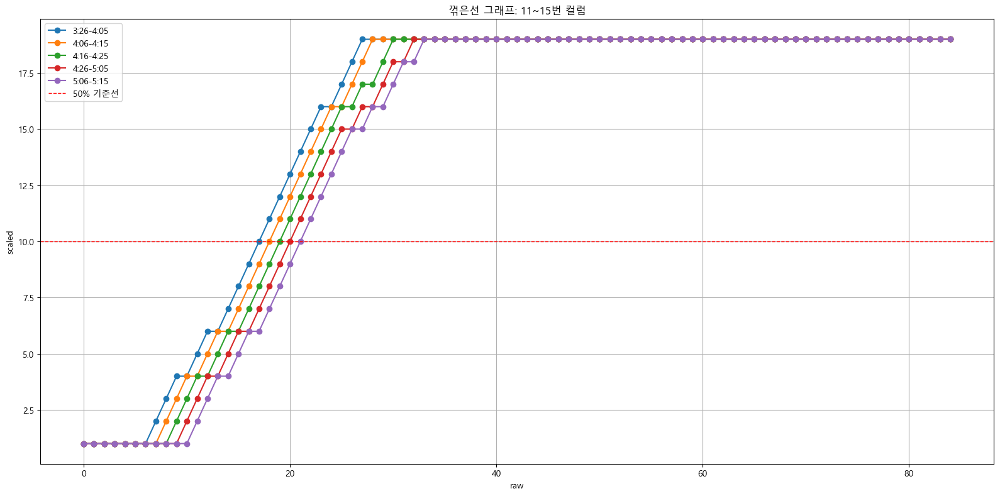

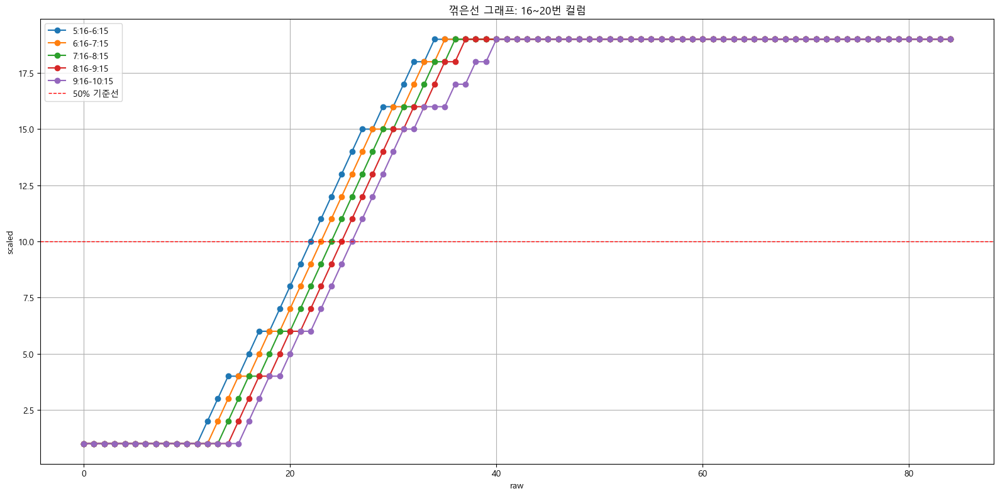

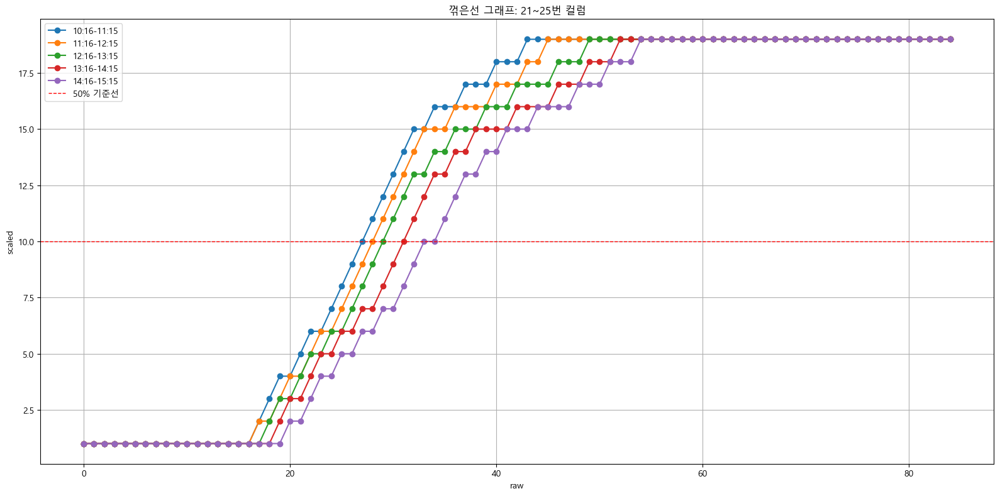

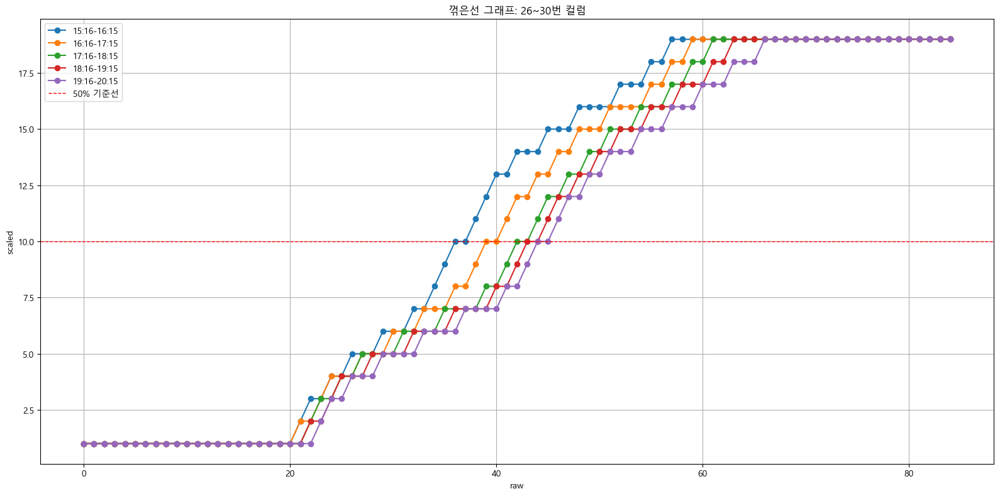

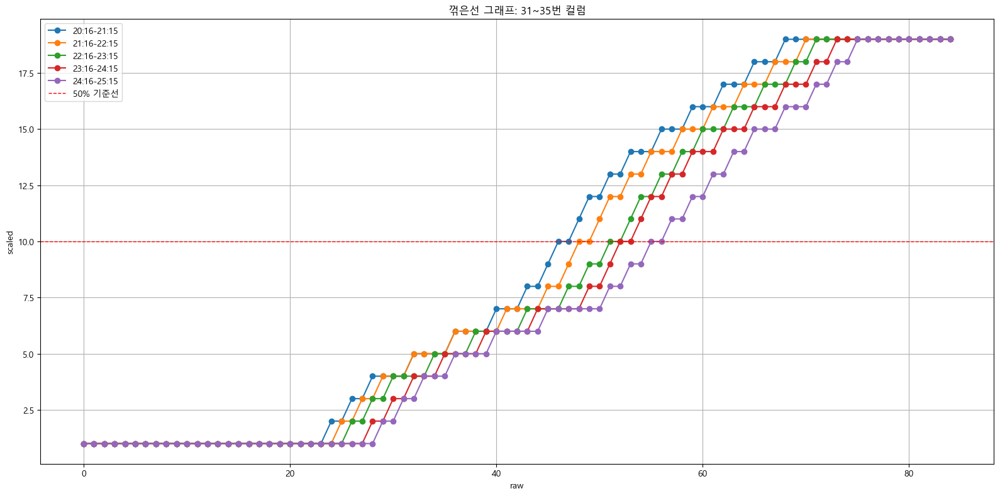

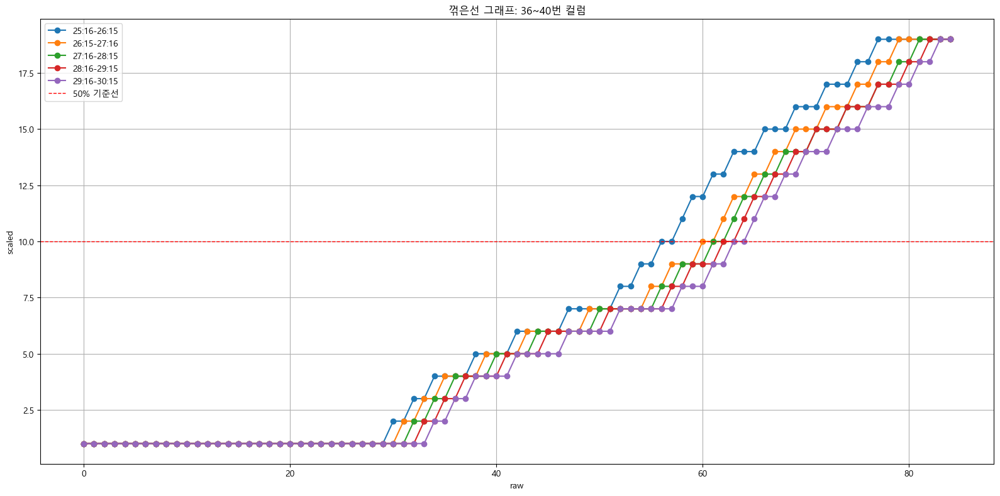

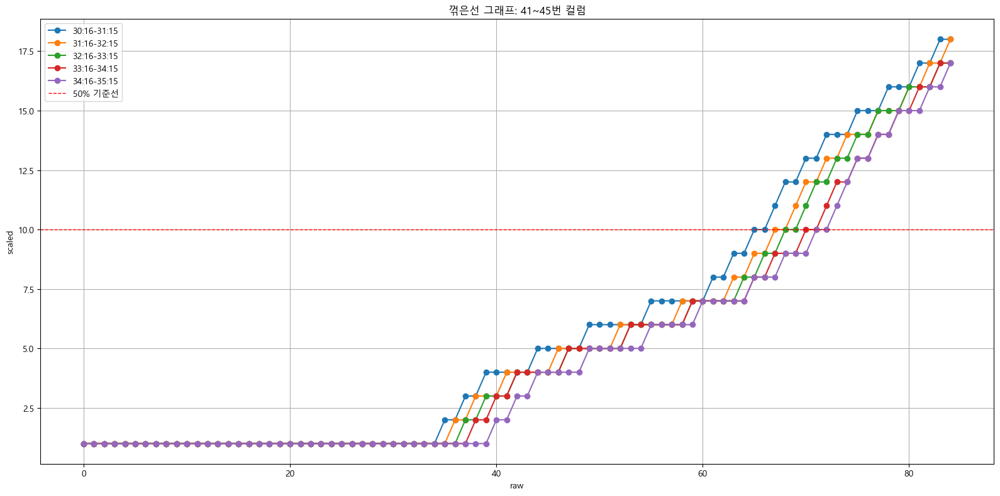

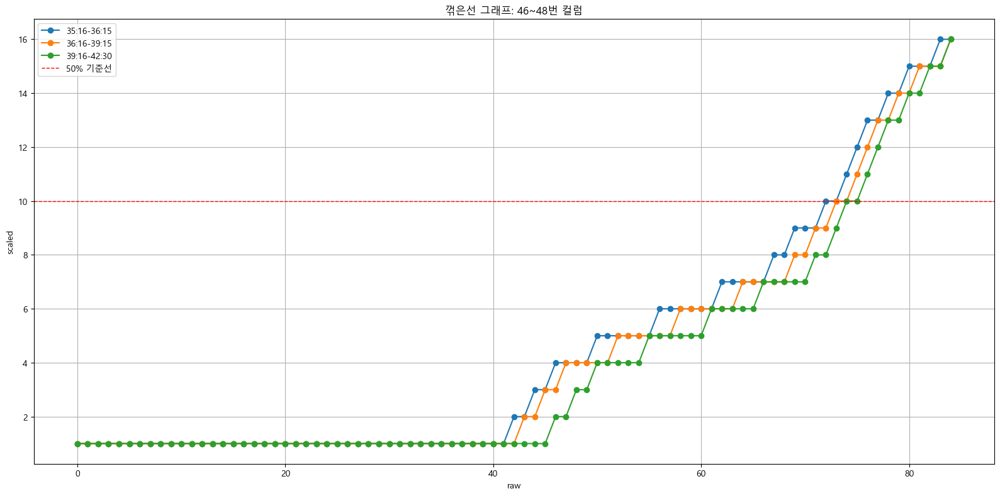

In [14]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 표현언어(KEC) 시각화

In [15]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='표현언어(KEC)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:16-0:25 0:26-1:05 1:06-1:15 1:16-1:25 1:26-2:05 2:06-2:15  \
0              1         -         -         -         0         0         0   
1              2         -         0         0         1         1       1-2   
2              3         0         -         1         -         2         3   
3              4         -         1         -         2         3         4   
4              5         1         -         2         3         4         5   
5              6         -         2         3         4         5         6   
6              7         2         3         4         5         6         7   
7              8         -         4         5         6         7         -   
8              9         3         -         -         -         -         8   
9             10         4         5         6         7         8         9   
10            11         5         -         -         -         -         -   
11            12         6         6    

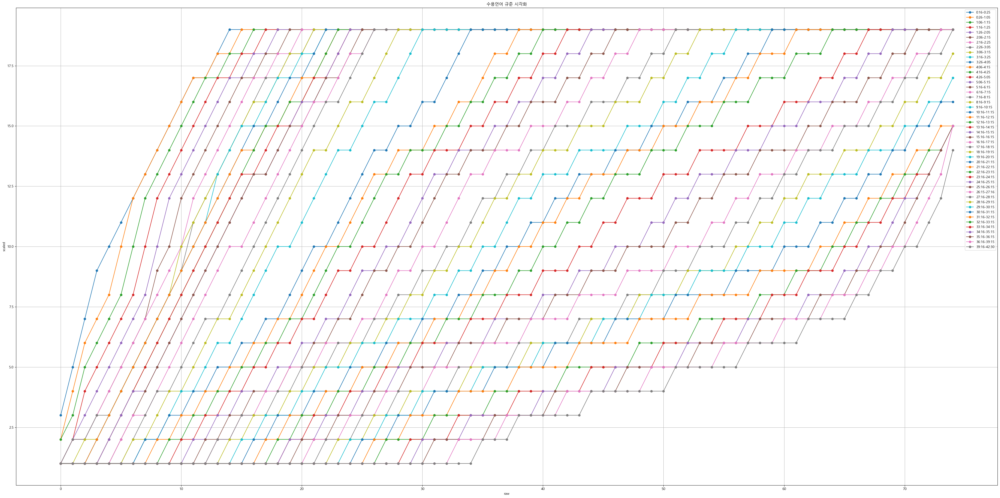

In [16]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

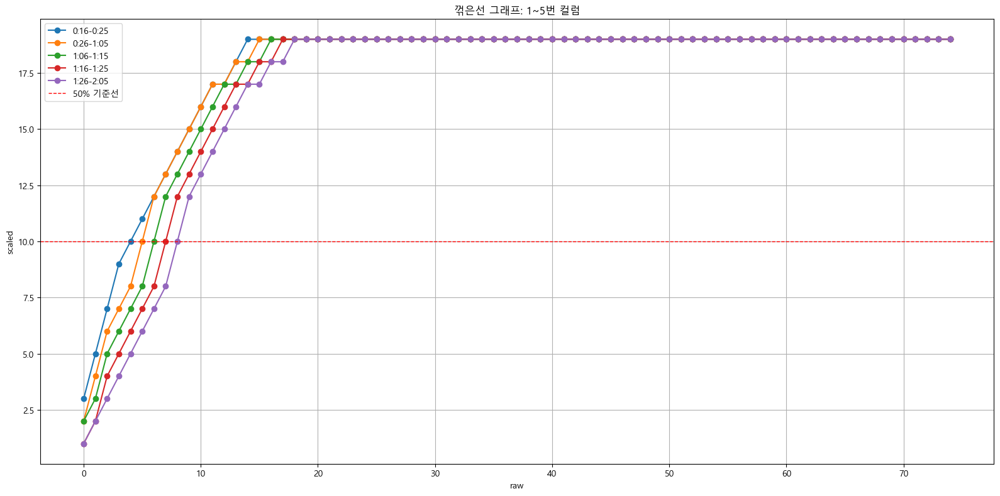

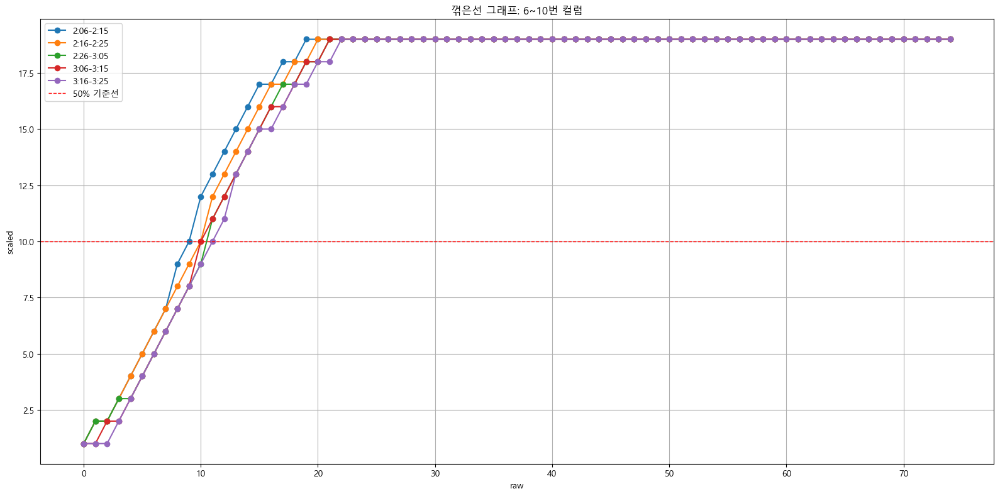

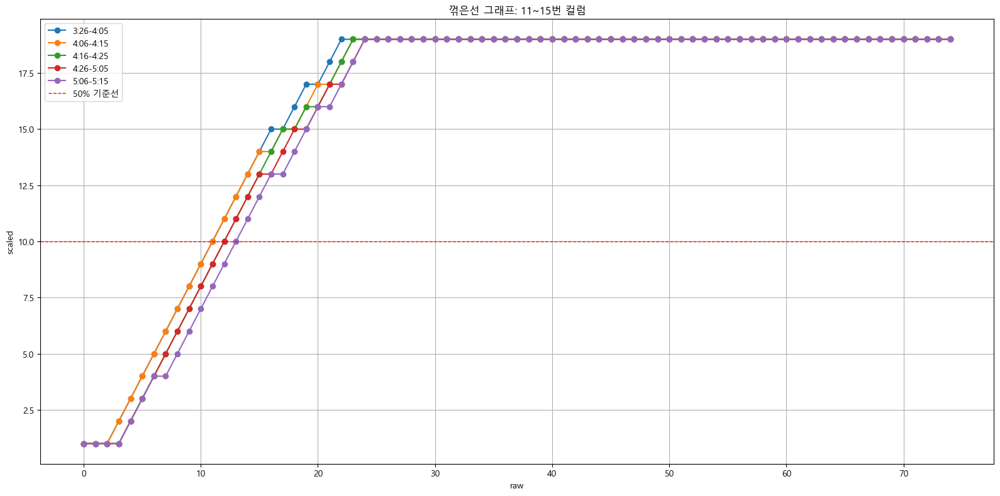

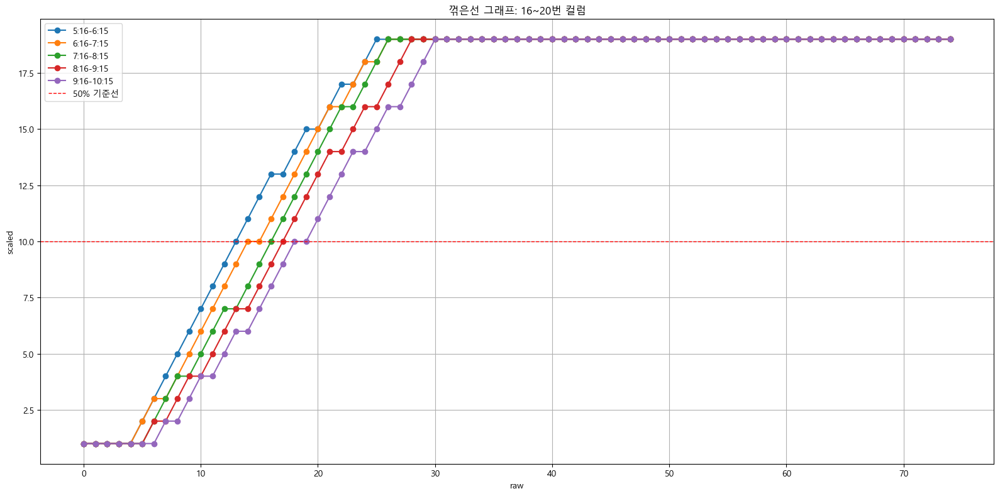

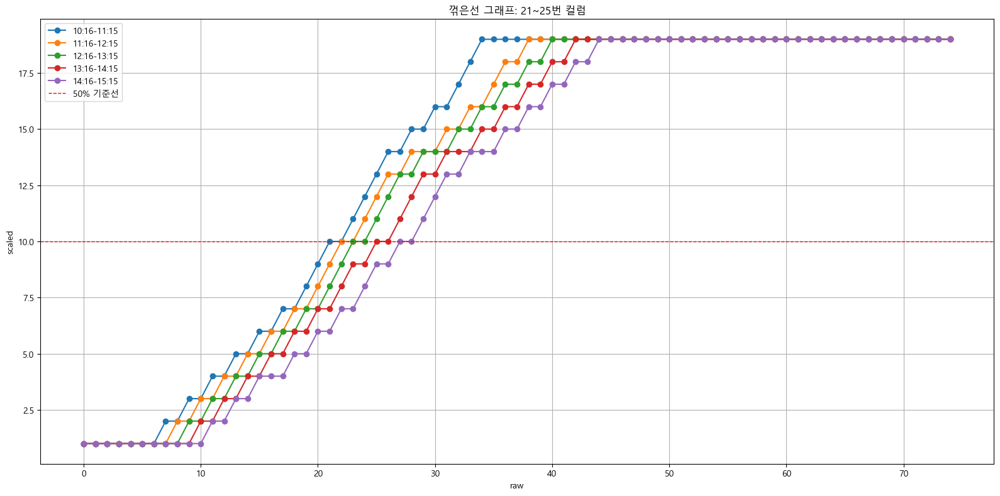

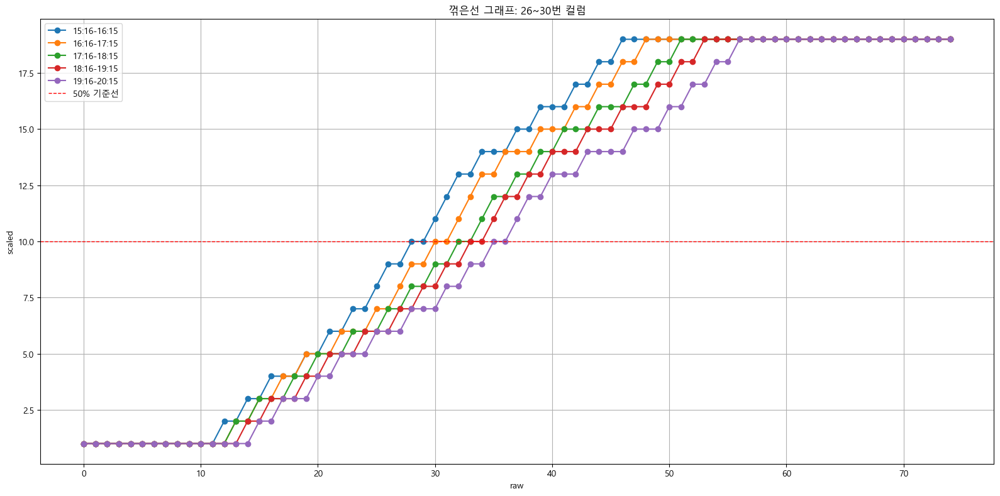

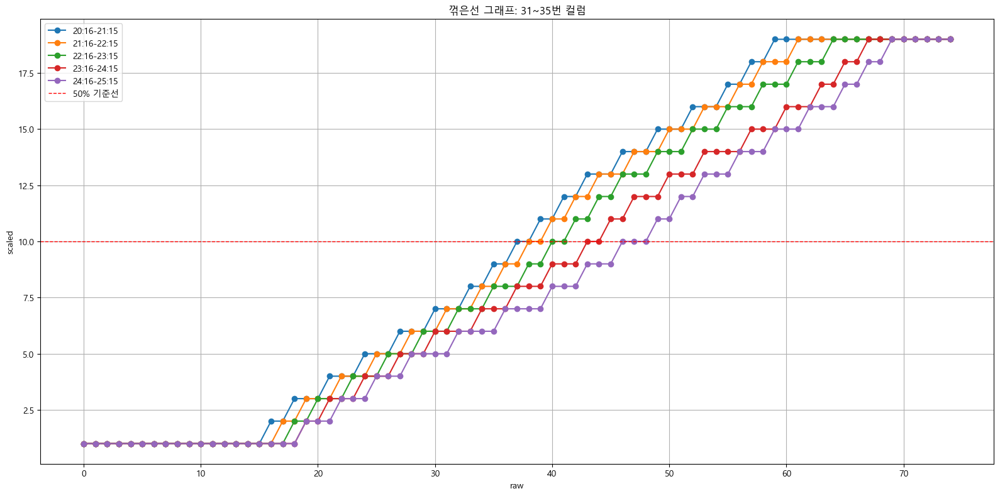

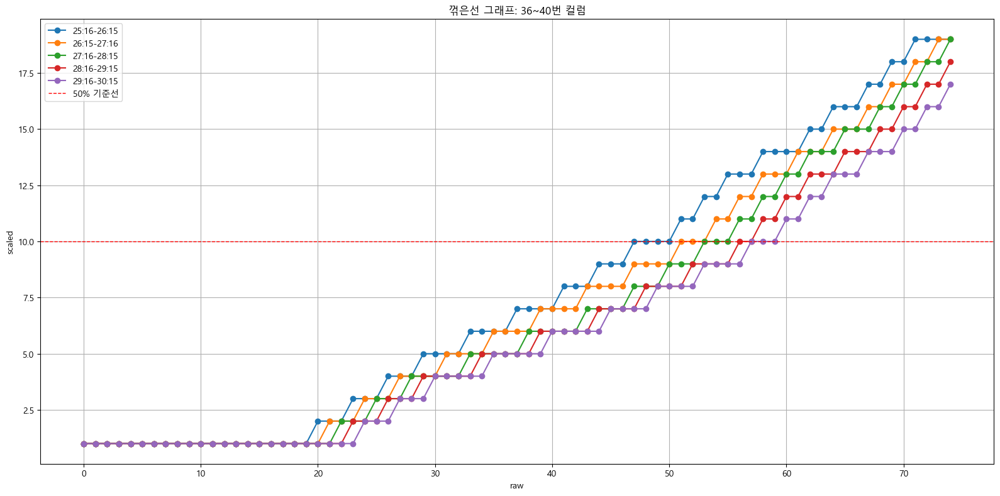

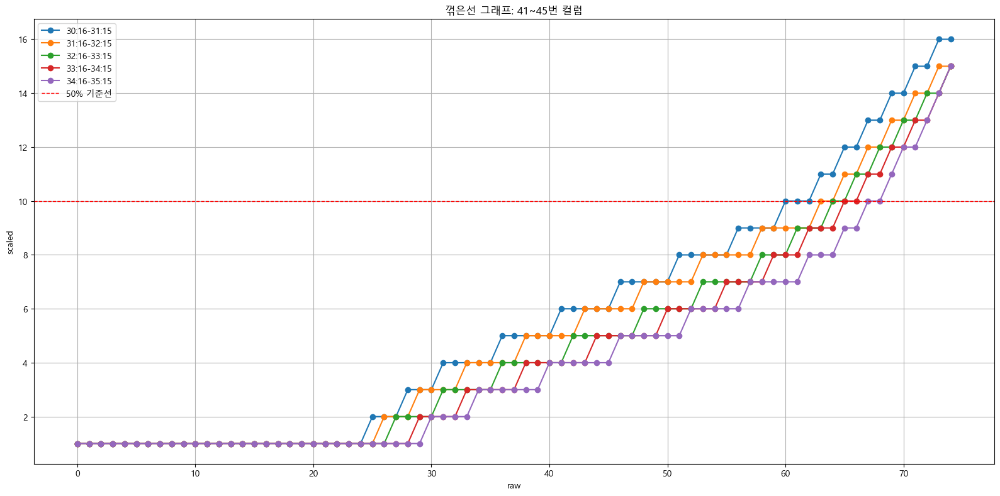

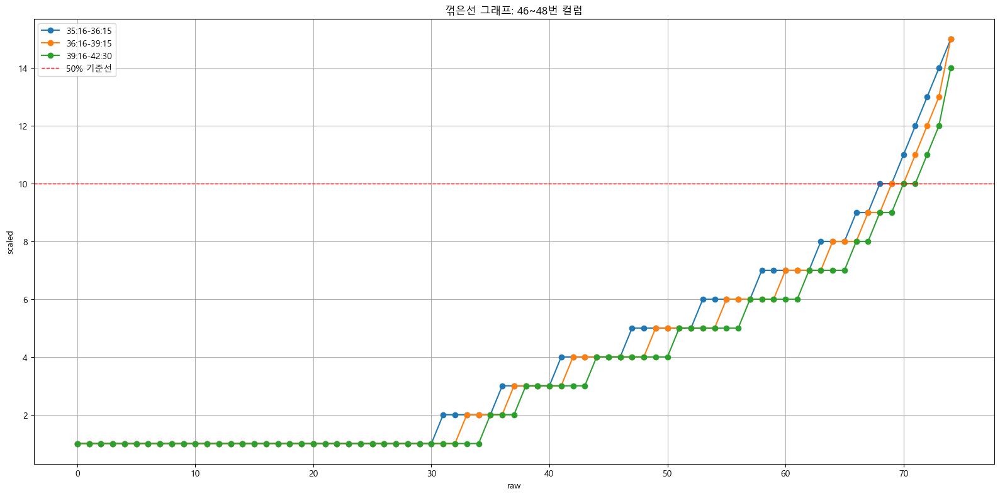

In [17]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 소근육 시각화

In [18]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='소근육(KFM)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:16-0:25 0:26-1:05 1:06-1:15 1:16-1:25 1:26-2:05 2:06-2:15  \
0              1         -         -         -         -         -         0   
1              2         -         -         -         -         0         1   
2              3         -         -         -         0         1         2   
3              4         -         0         0         1         2       3-4   
4              5         0         -         1         2         3         5   
5              6         -         1         2         3         4         6   
6              7         1         2         3         4         5         7   
7              8         2         3         4         5         6         8   
8              9         3         4         5         6         7         9   
9             10       4-5       5-6         6       7-8         8        10   
10            11         6         7       7-8         9      9-10        11   
11            12         7         8    

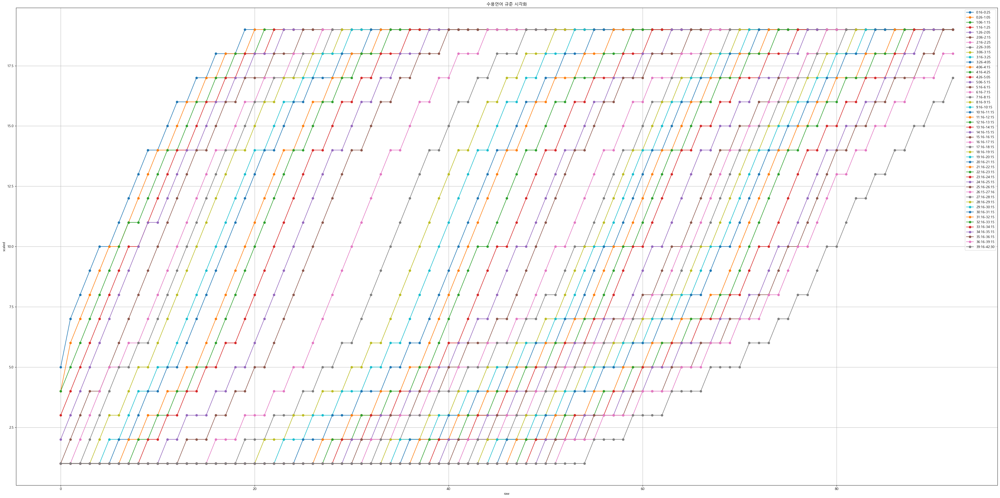

In [19]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

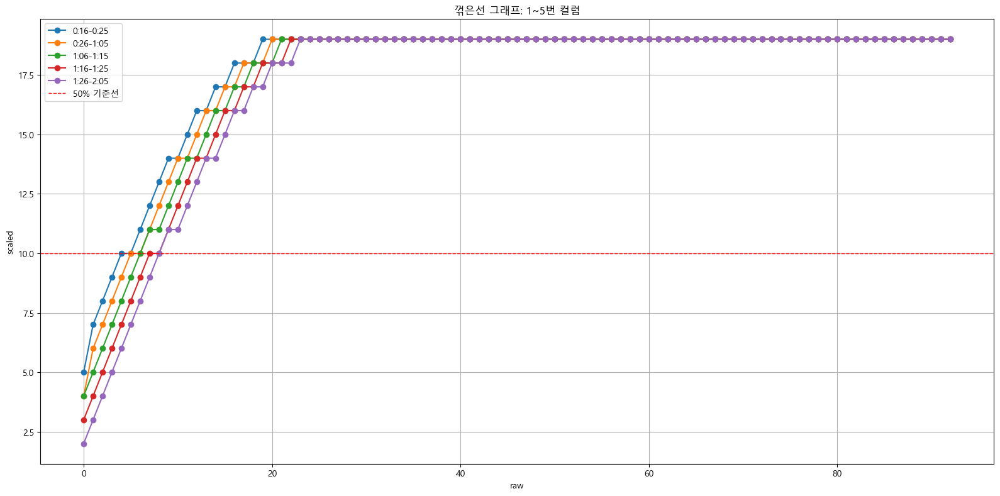

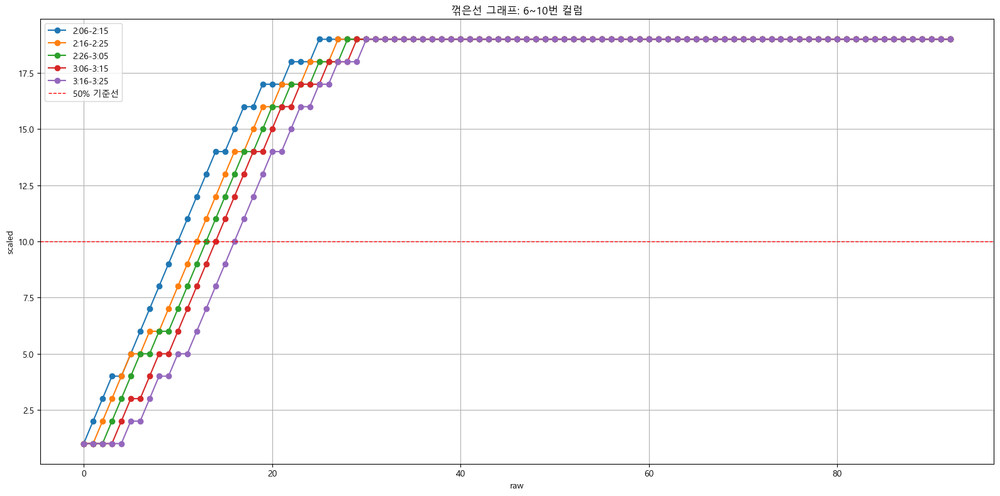

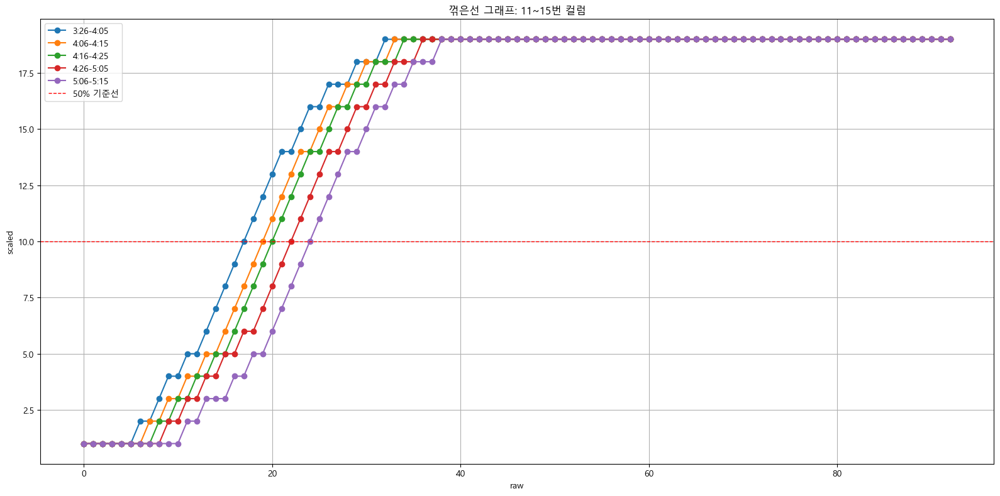

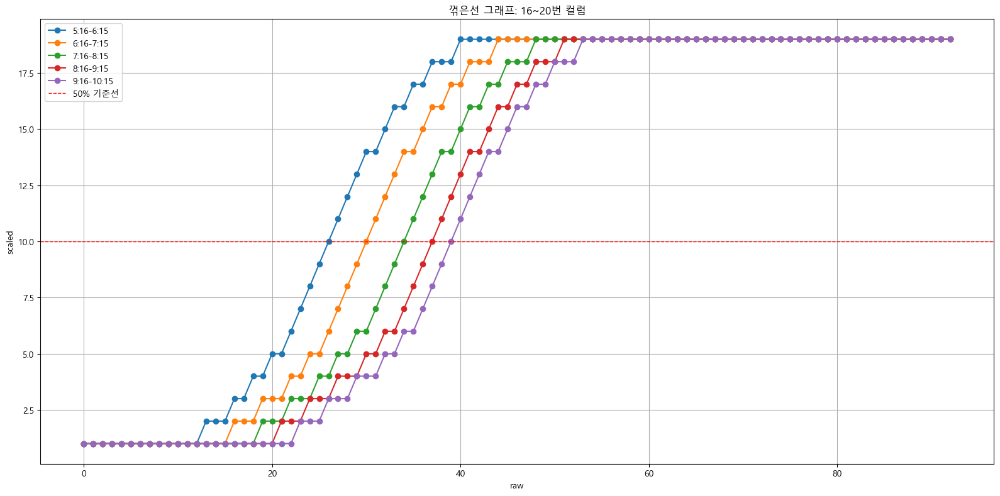

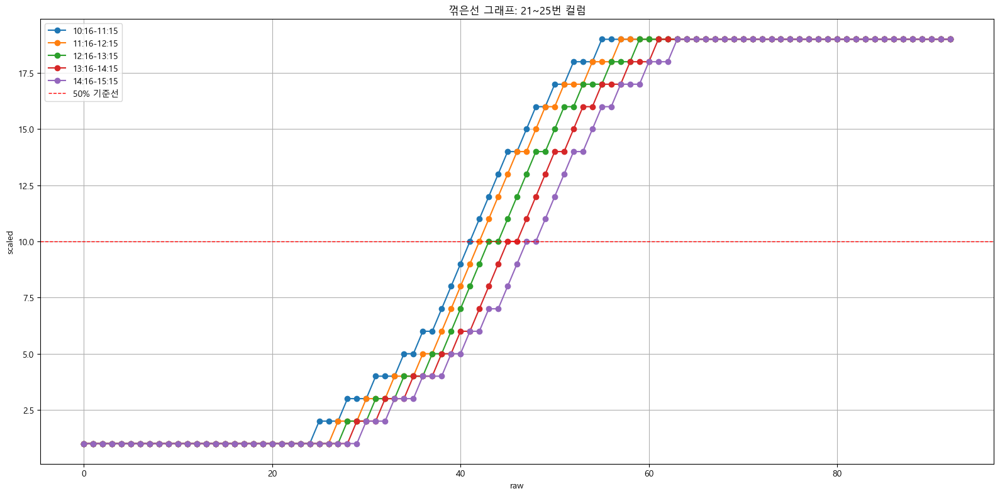

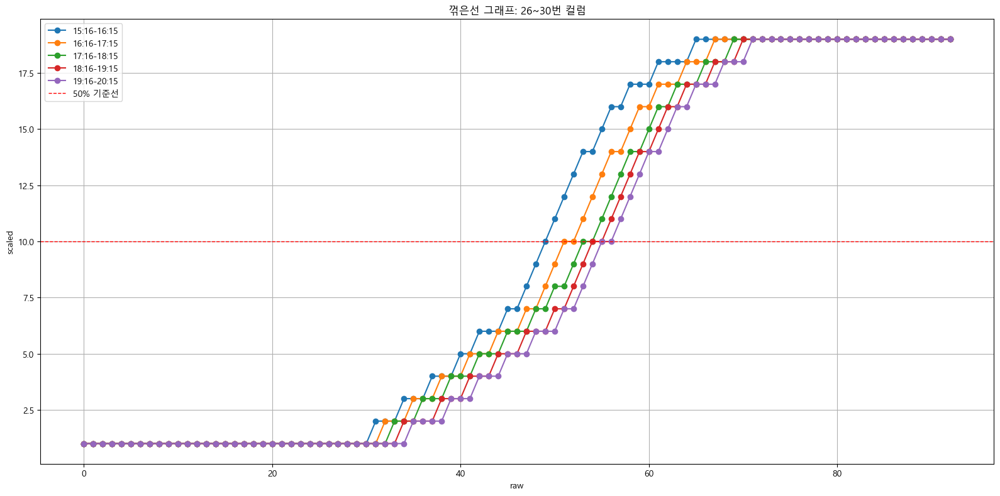

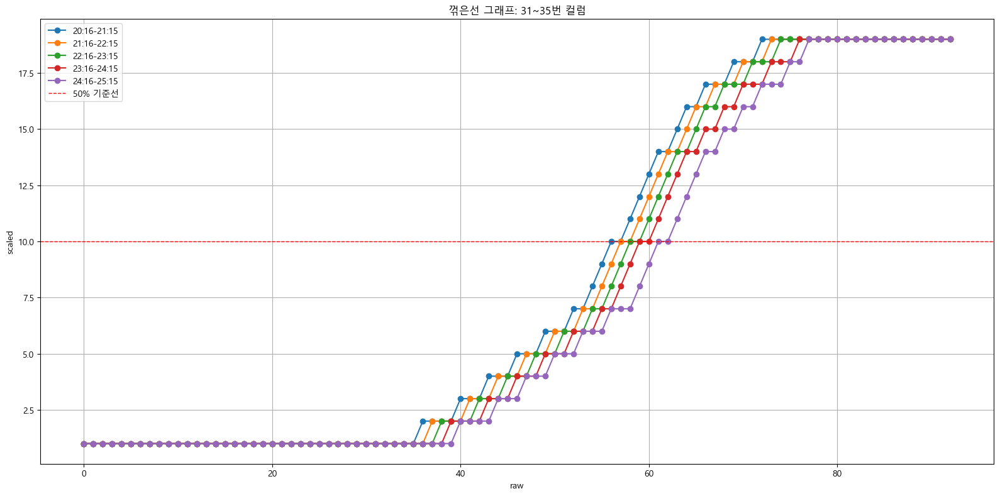

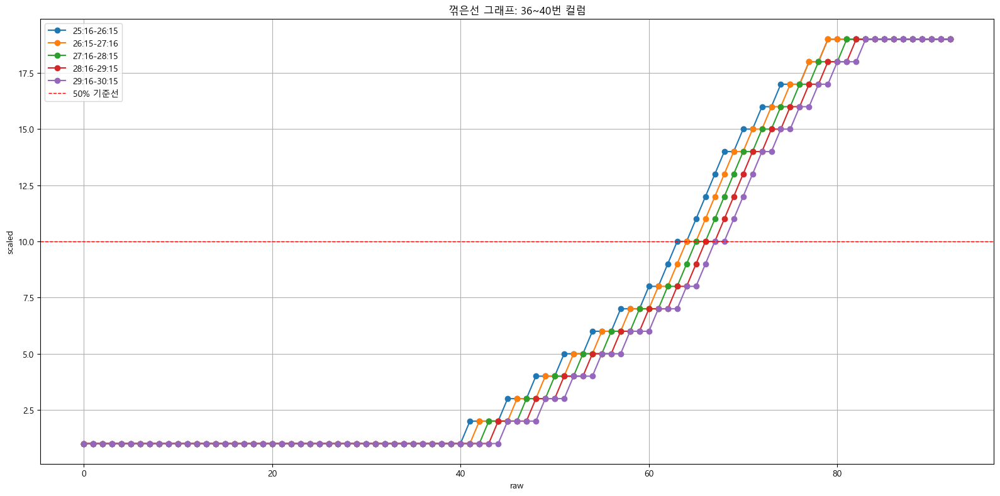

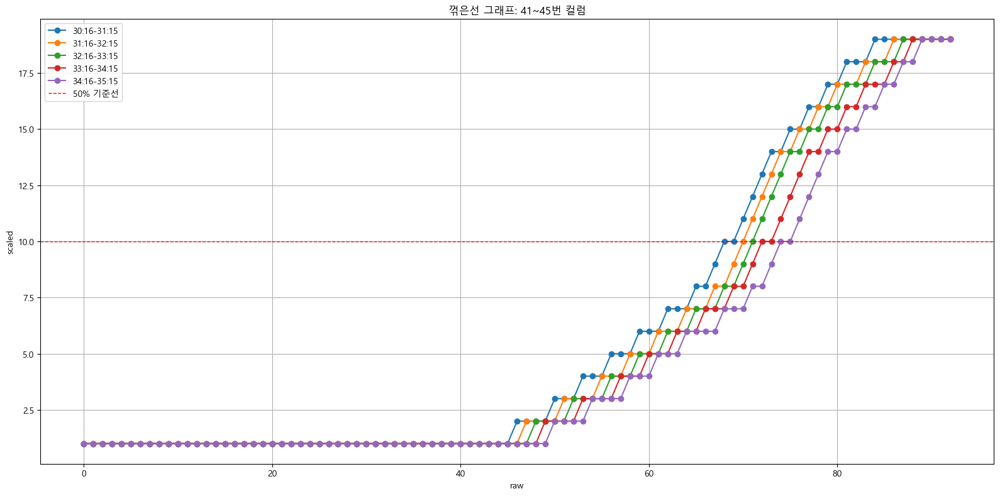

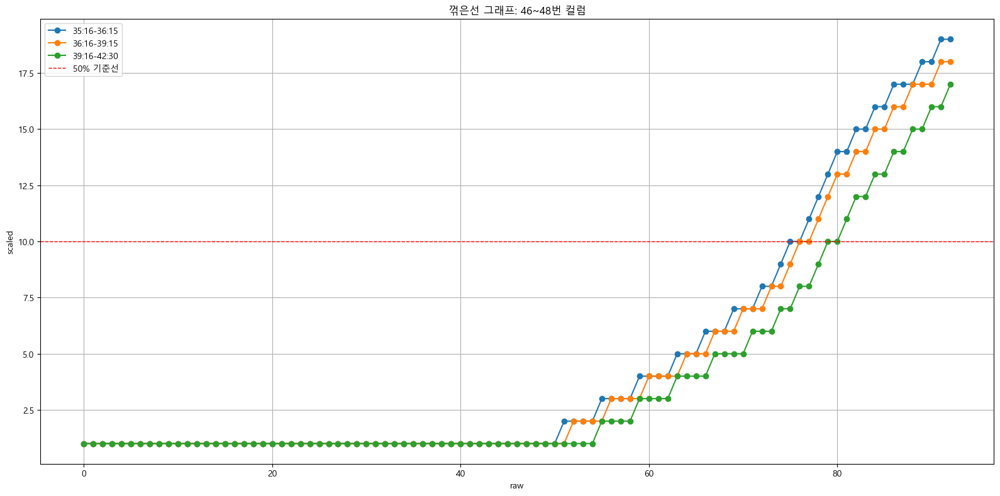

In [20]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 대근육 시각화

In [21]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='대근육(KGM)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:16-0:25 0:26-1:05 1:06-1:15 1:16-1:25 1:26-2:05 2:06-2:15  \
0              1         -         -         -         -         -         0   
1              2         -         -         -         -         0         1   
2              3         -         -         -         0         1         2   
3              4         -         -         0         1         2       3-4   
4              5         -         0         1         2       3-4       5-6   
5              6         0         1         2       3-4       5-6       7-9   
6              7         1         2         3       5-6       7-8     10-11   
7              8         2         3       4-5       7-8      9-10        12   
8              9         3         4         6         9        11        13   
9             10         4         5         7        10        12        14   
10            11         5         6         8        11        13        15   
11            12       6-7       7-8    

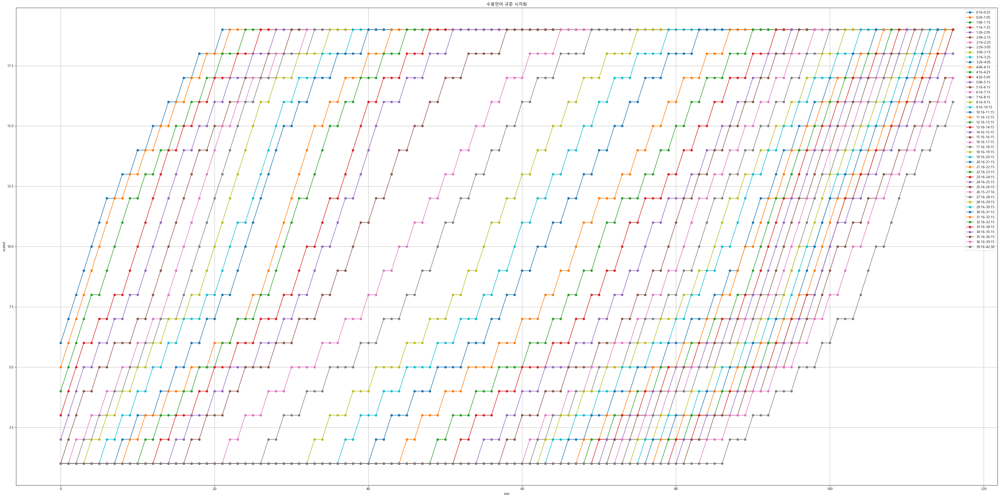

In [22]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

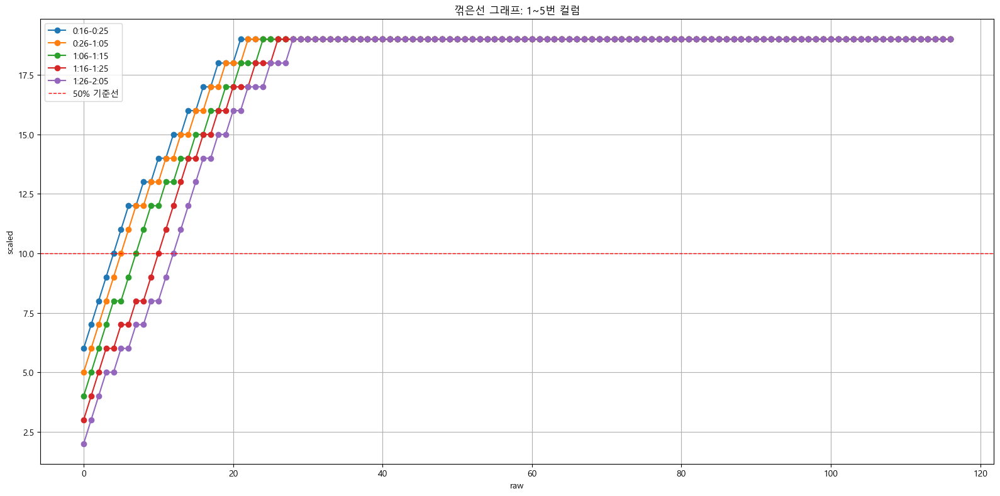

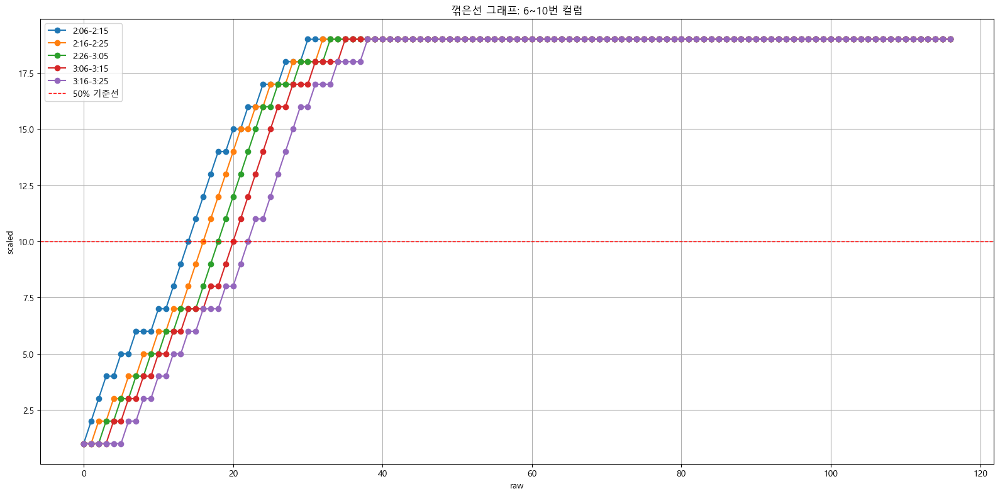

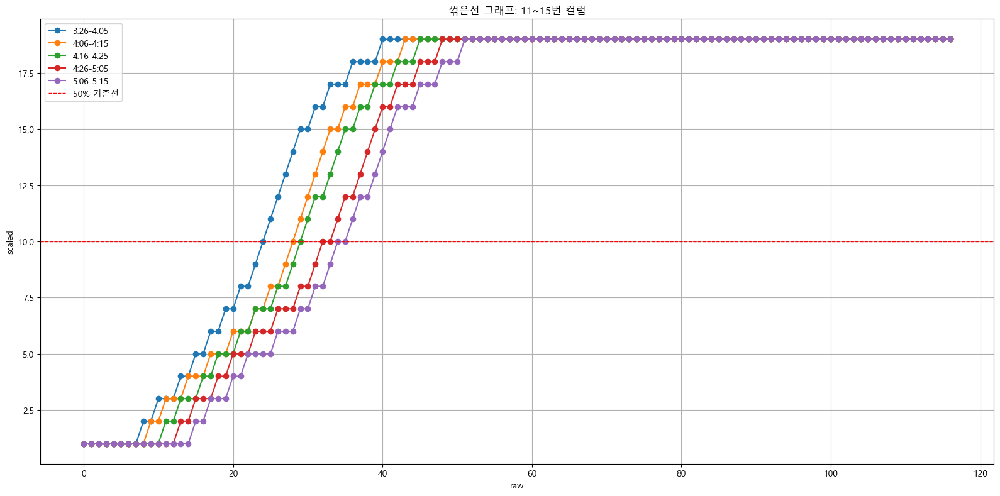

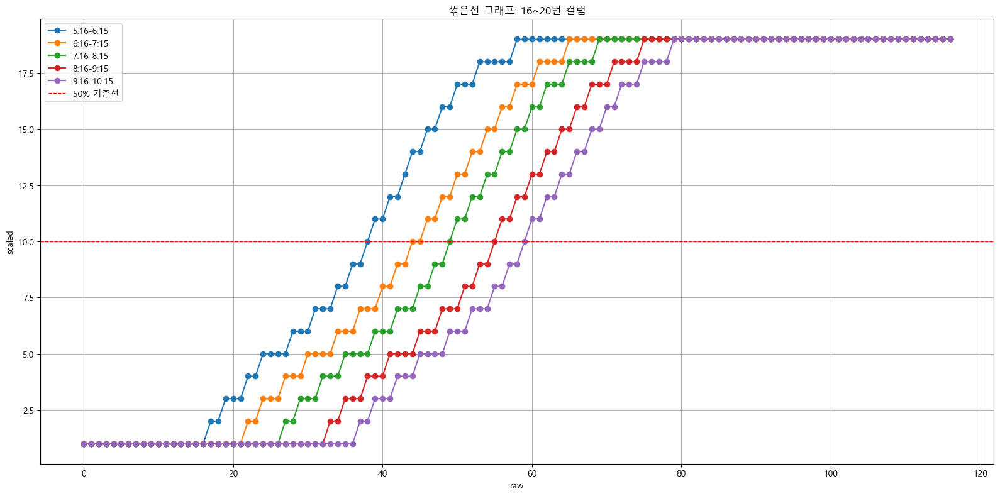

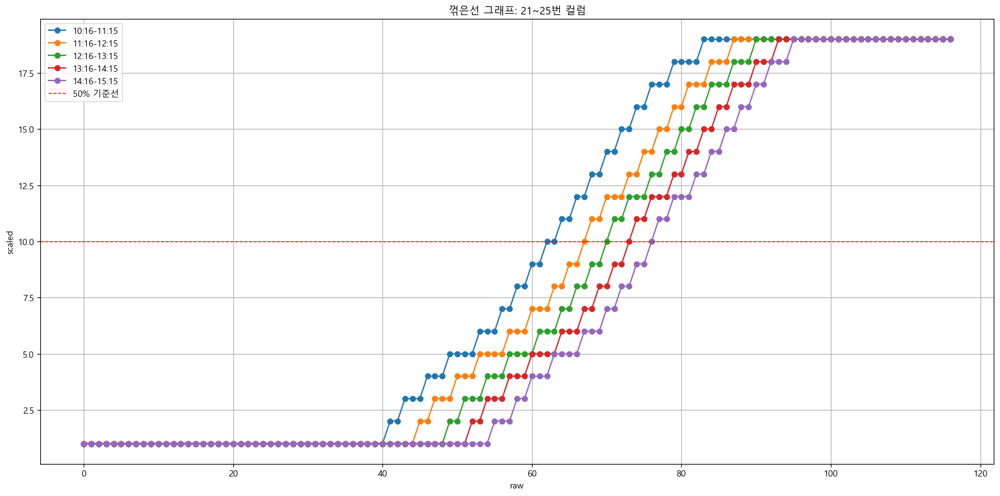

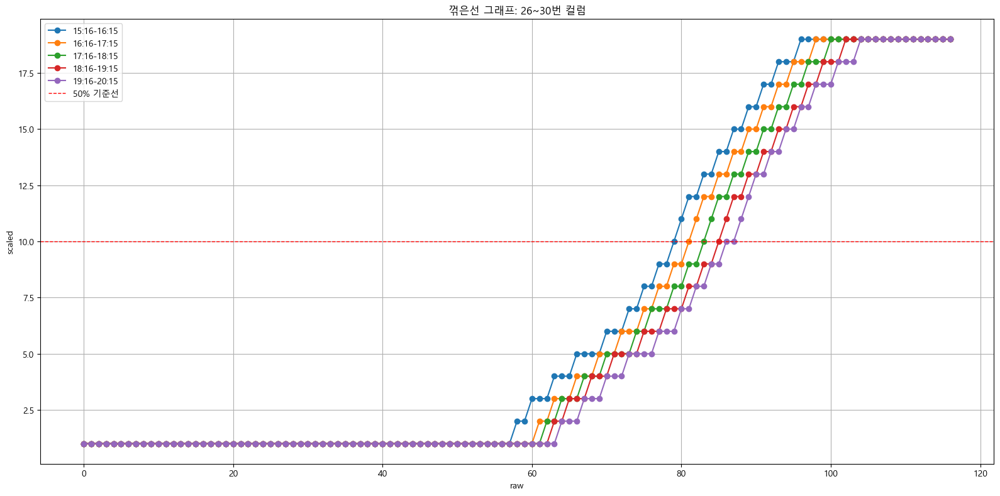

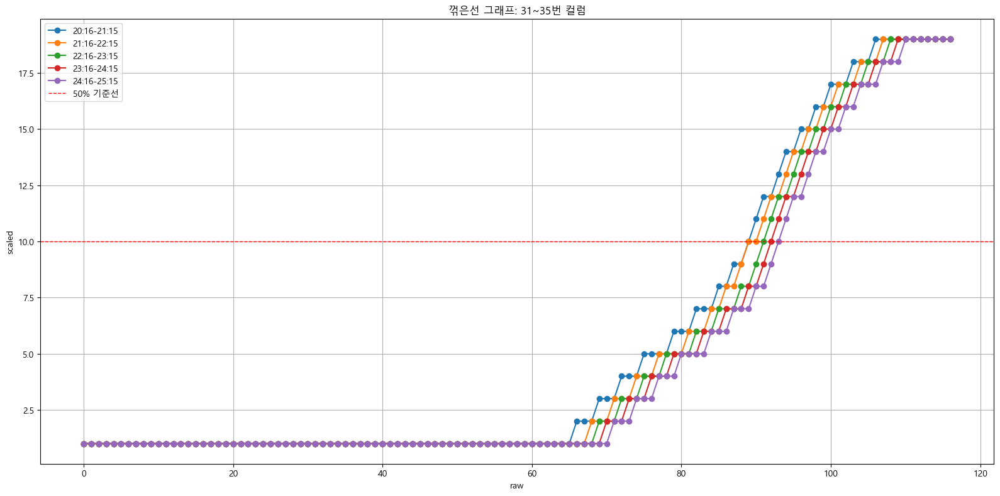

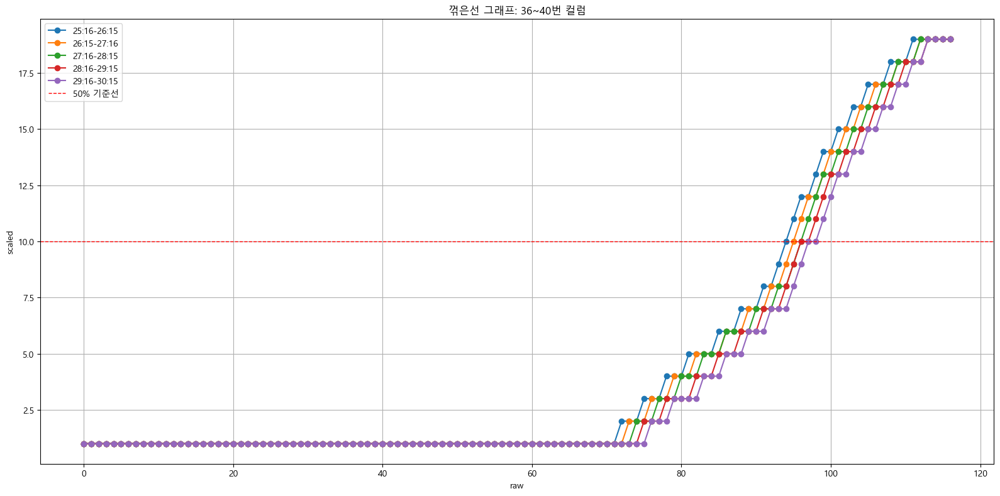

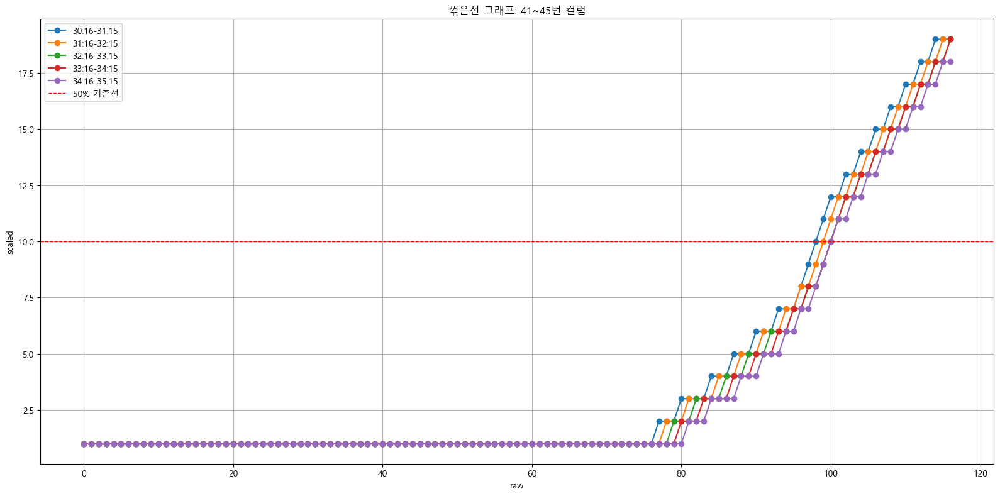

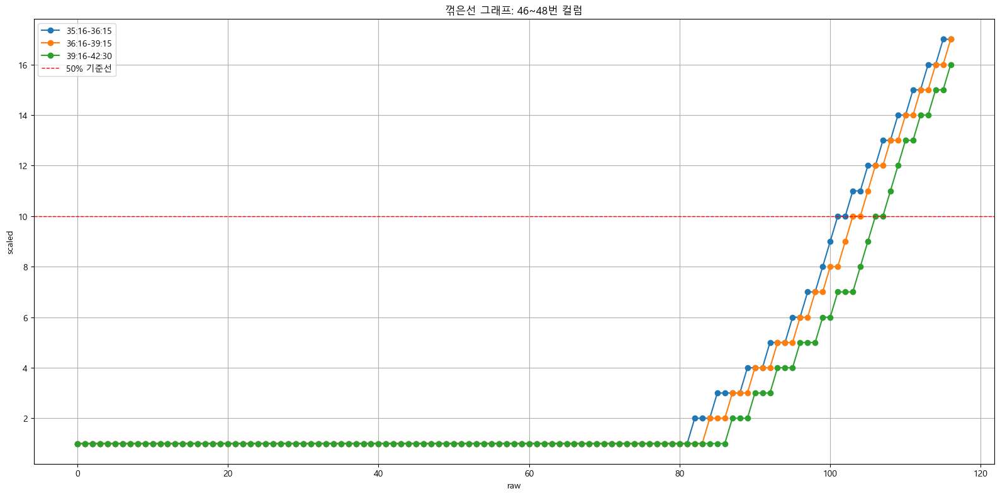

In [23]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 사회정서 시각화

In [24]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='사회정서(KSE)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=0, raw_max=175)

    scaled score 0:00-3:30 4:00-5:30 6:00-9:30 10:00-14:30 15:00-18:30  \
0              1      0-10      0-29      0-42        0-48        0-55   
1              2     11-15     30-32     43-46       49-50       56-59   
2              3     16-20     33-34     47-50       51-53       60-64   
3              4     21-24     35-39     51-53       54-57       65-69   
4              5     25-29     40-43     54-56       58-61       70-74   
5              6     30-32     44-46     57-59       62-65       75-79   
6              7     33-35     47-49     60-62       66-68       80-84   
7              8     36-38     50-52        63       69-70       85-87   
8              9     39-41     53-54        64       71-72       88-89   
9             10     42-43     55-56     65-66       73-74       90-91   
10            11     44-45     57-58        67       75-76       92-93   
11            12     46-47        59        68       77-79       94-95   
12            13     48-49     60-61  

In [25]:
result_df
# 전처리 함수가 사회정서와 같이 연령별로 원점수 범위가 다른 경우
# 지금 전처리 함수에선 첫번째 연령을 기준으로 원점수 범위를 산출해 고정하기 때문에 문제가 발생함
# 전처리 함수를 첫번째 연령이 아니라 마지막 연령 기준으로 원점수 범위를 산출하도록하면 될거 같은데

,raw,0:00-3:30,4:00-5:30,6:00-9:30,10:00-14:30,15:00-18:30,19:00-24:30,25:00-30:30,31:00-42:30
0,0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1
1,1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1
2,2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1
3,3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1
4,4,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1
...,...,...,...,...,...,...,...,...,...
171,171,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14
172,172,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15
173,173,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16
174,174,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17


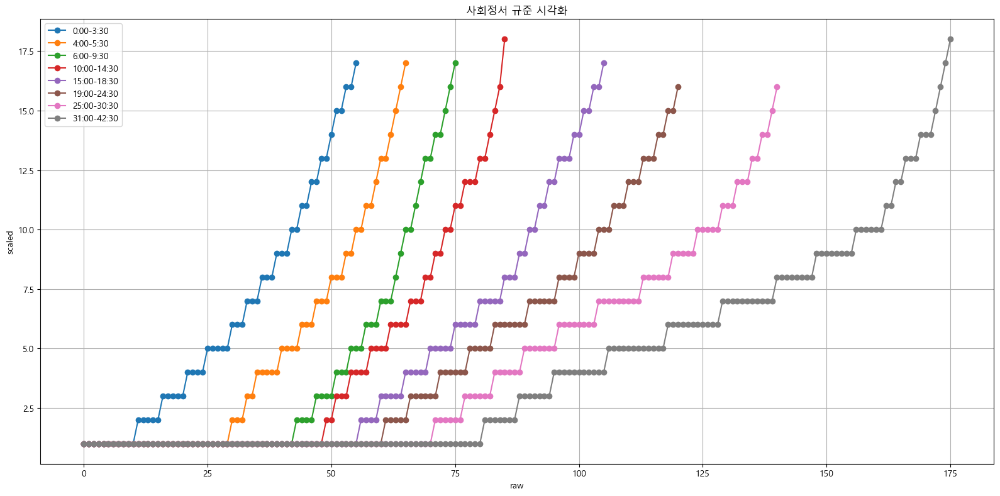

In [26]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(16, 8))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('사회정서 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

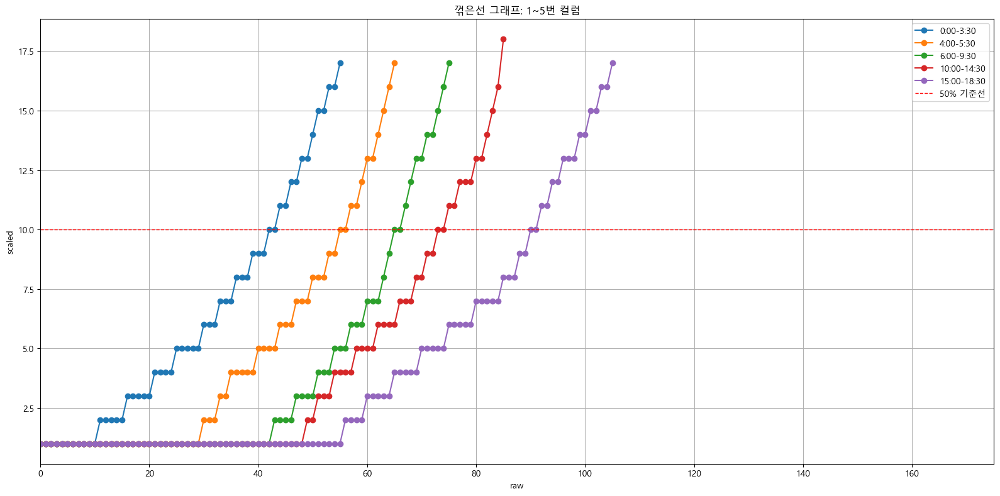

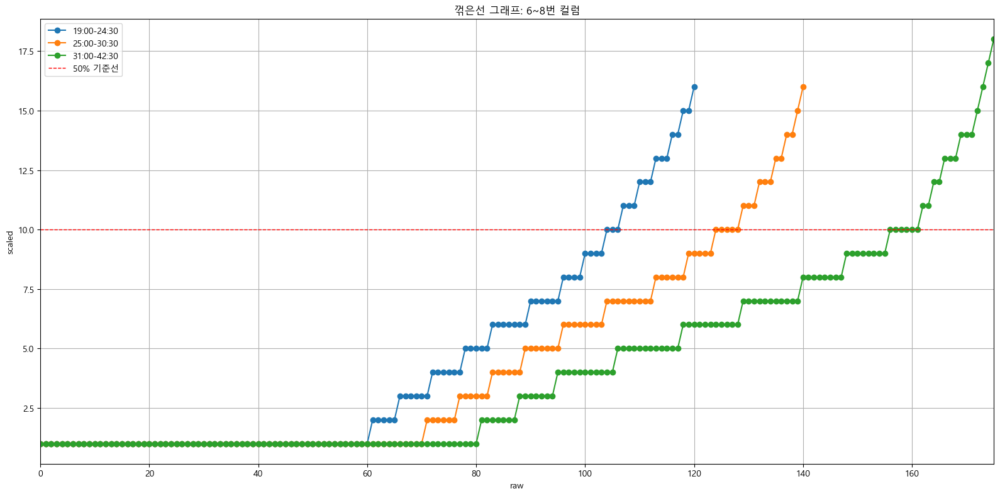

In [27]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.xlim(0, 175)  # y축 범위를 0~20으로 고정
    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    '''
    환산점수는 원점수를 연령에 맞게 조정한 상대위치이기 때문에
    연령별로 점수 범위가 다르기 때문에 다른 연령 간 점수 비교가 어려워짐

    특정 연령대는 쉽게 환산점수 최대치를 받는 반면
    다른 연령대는 비슷하게 잘해도 최대치를 도달하지 못하는 상황이 있을 수 있음
    '''

### 적응행동_수용 시각화

In [28]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='적응행동_수용(KREC)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:00-0:30 1:00-1:30 2:00-2:30 3:00-3:30 4:00-4:30 5:00-5:30  \
0              1         -         -         -         -         -         -   
1              2         -         -         -         -         -         0   
2              3         -         -         -         -       0-1         1   
3              4         -         -         -         0         2         2   
4              5         -         -       0-1       1-2         3         3   
5              6         0         0         2         3         4         4   
6              7         1       1-2         3         4         5         5   
7              8         2         3         4         5         6         6   
8              9         3         4         5         6         7         7   
9             10         4         5         6         7         8         8   
10            11         5         6         -         8         9         9   
11            12         6         -    

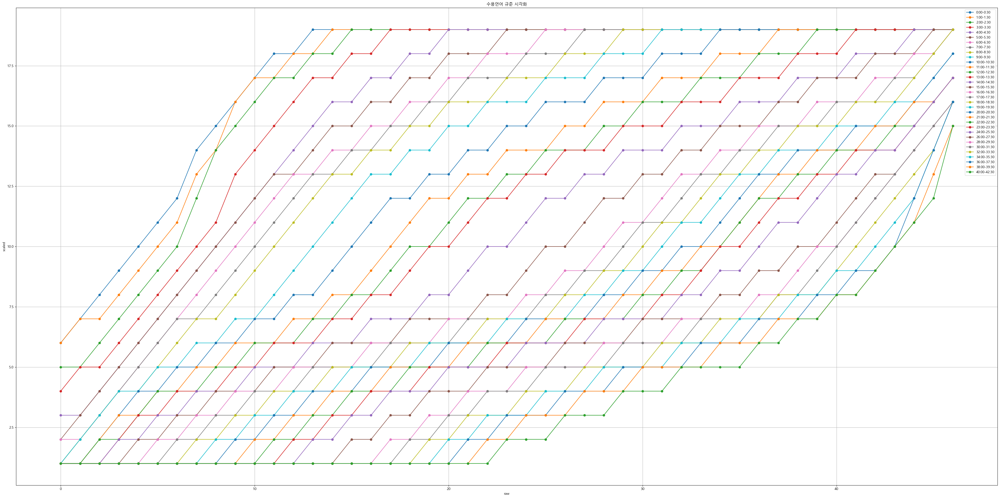

In [29]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

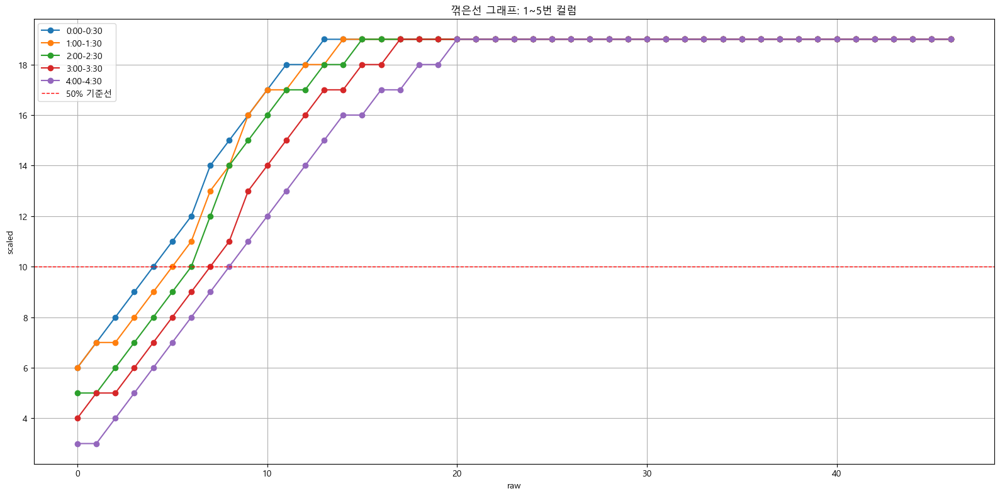

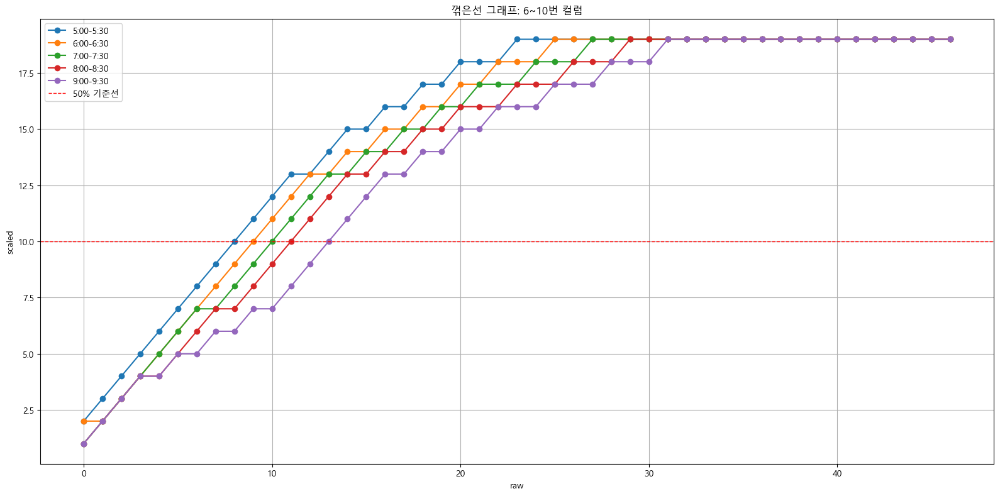

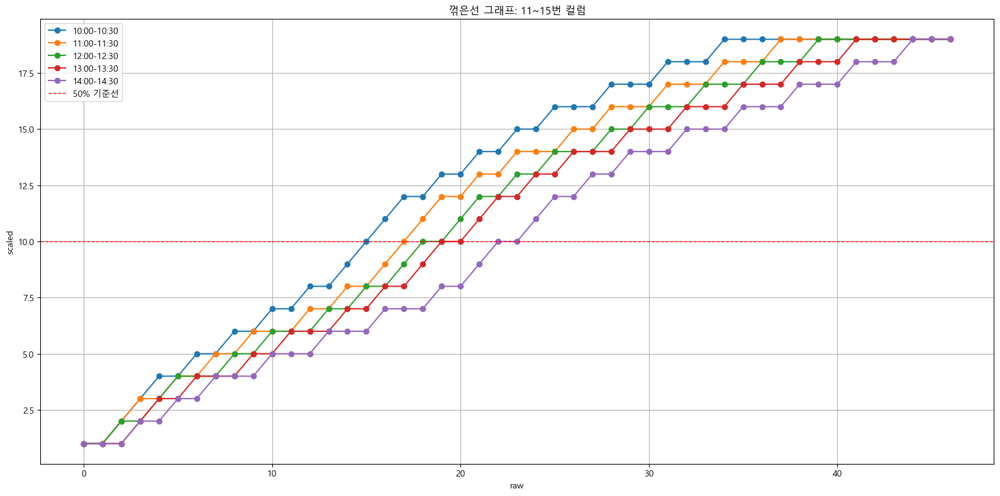

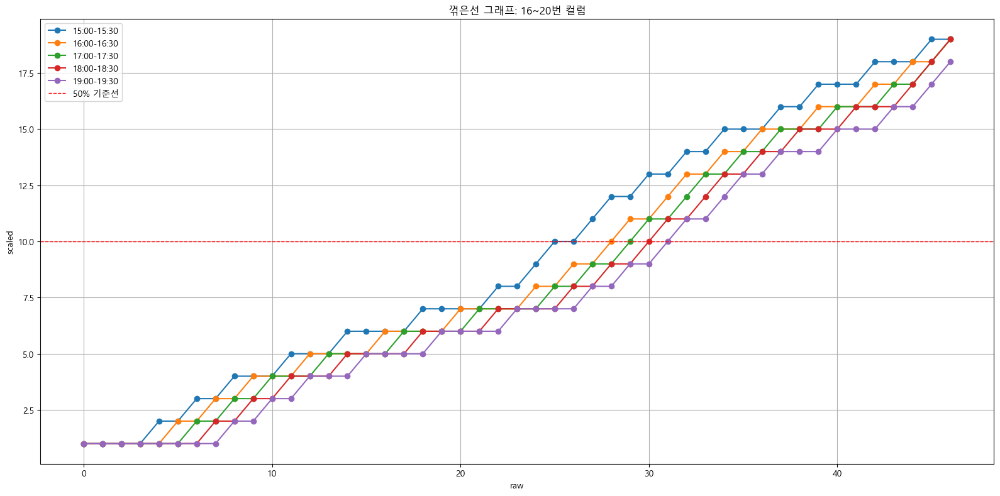

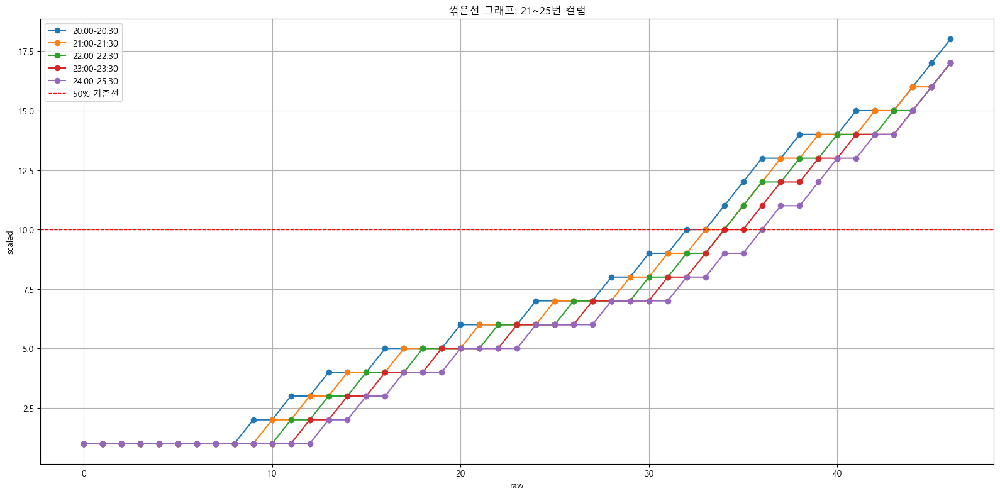

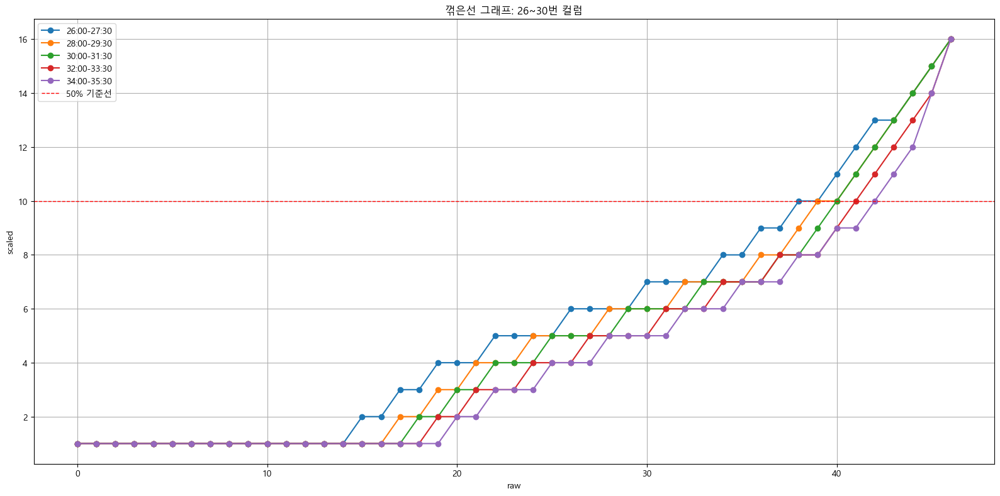

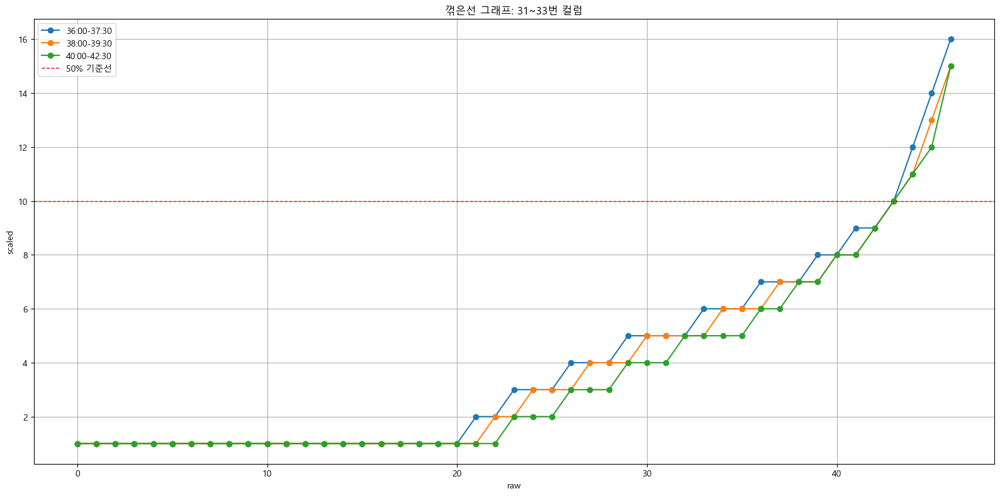

In [30]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 적응행동_표현 시각화

In [31]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='적응행동_표현(KEXP)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:00-0:30 1:00-1:30 2:00-2:30 3:00-3:30 4:00-4:30 5:00-5:30  \
0              1         -         -         -         -         -         -   
1              2         -         -         -         -         -         -   
2              3         -         -         -         -         -         -   
3              4         -         -         -         -         -         -   
4              5         -         -         -         0         0         0   
5              6         -         0         0         -         1         1   
6              7         0         -         1         1         2         2   
7              8         -         1         -         2         -         3   
8              9         1         -         2         3         3         4   
9             10         -         2         3         -         4         5   
10            11         2         -         -         4         -         -   
11            12         -         3    

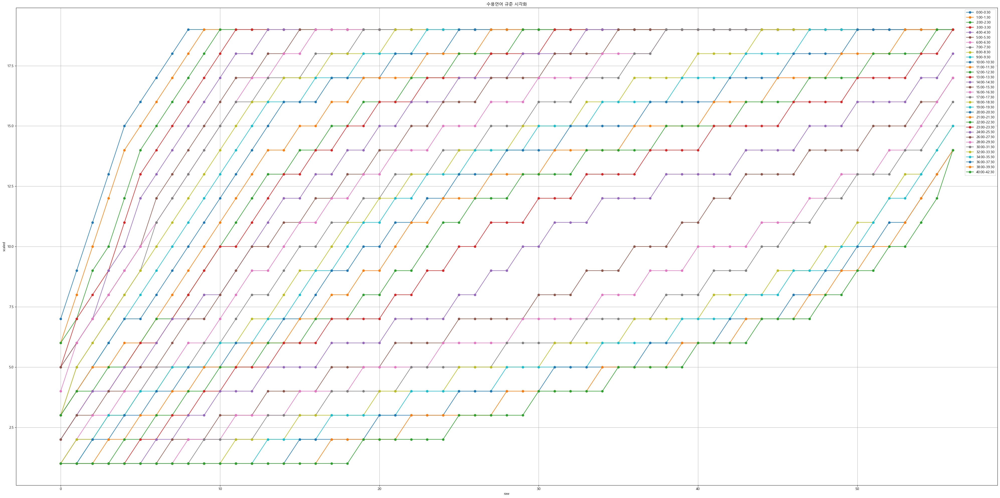

In [32]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

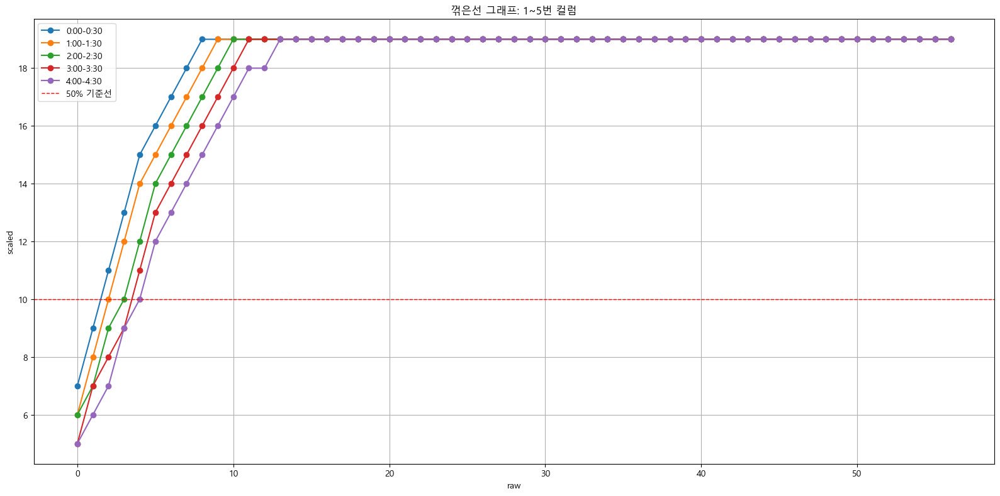

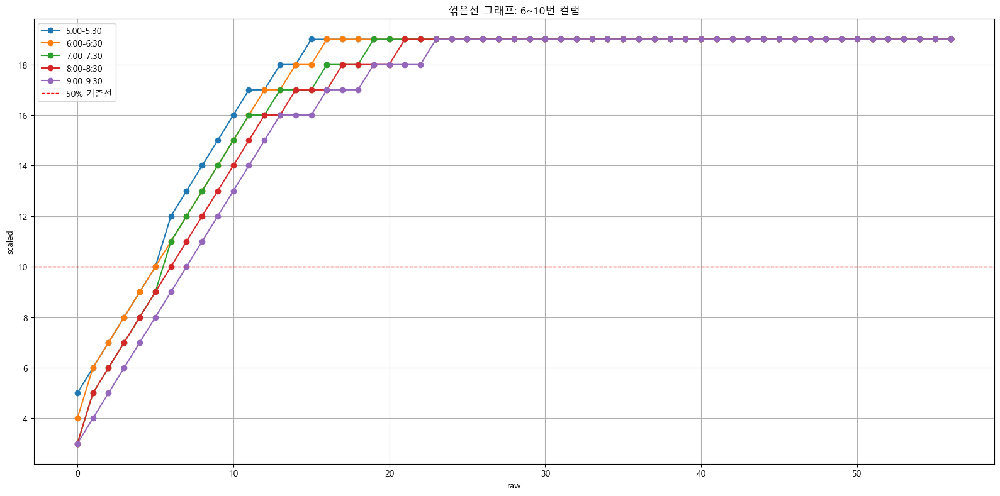

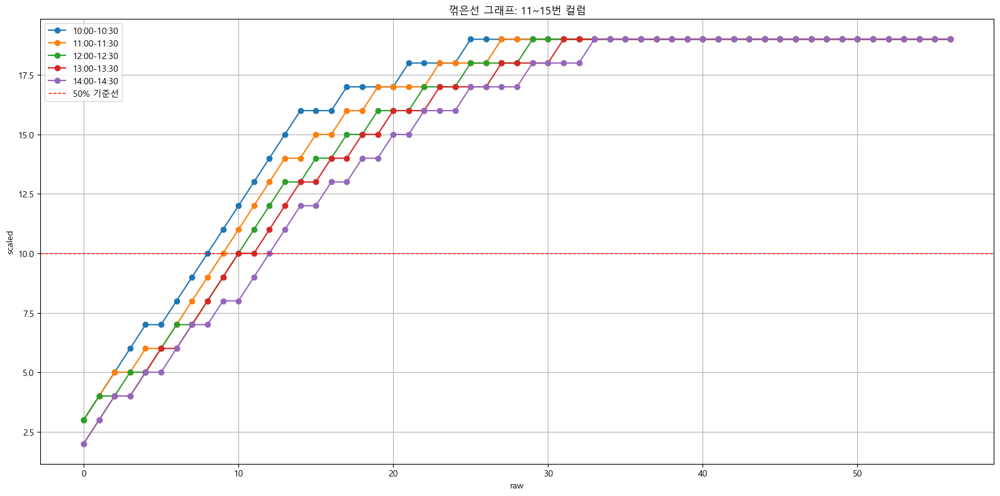

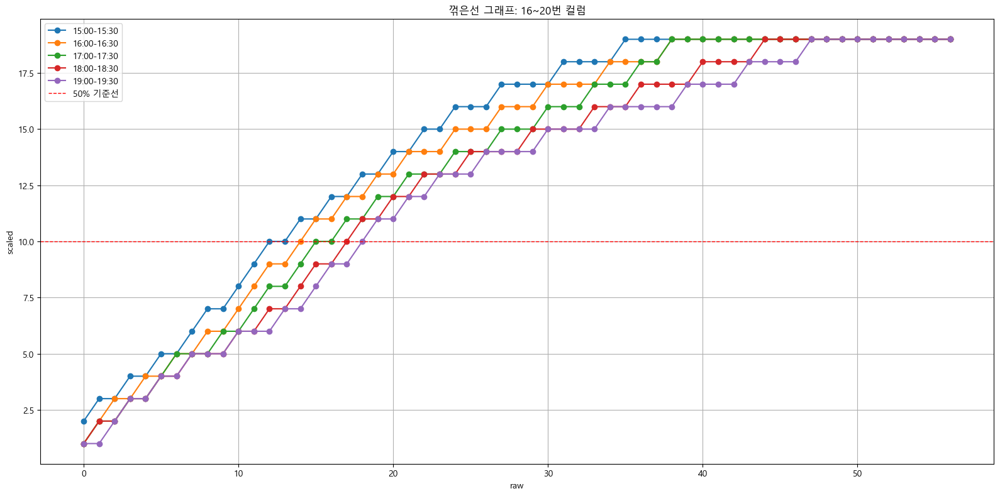

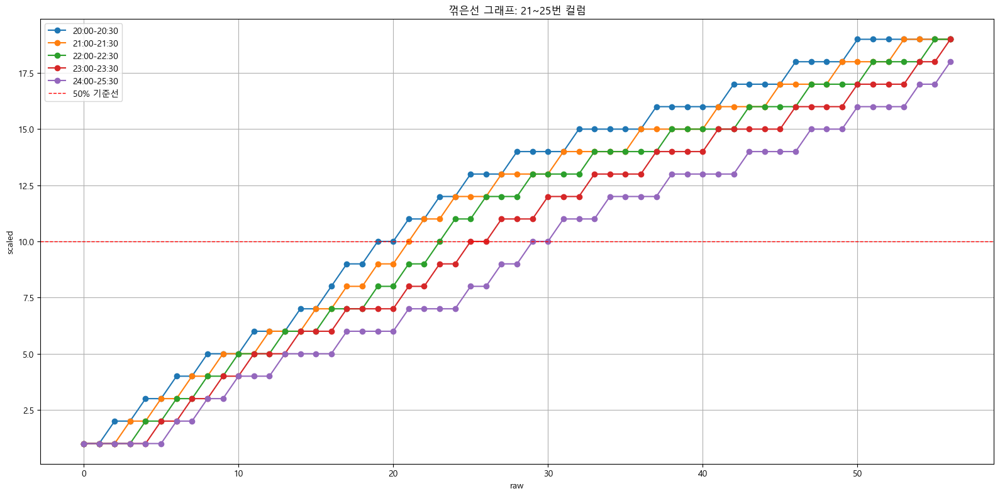

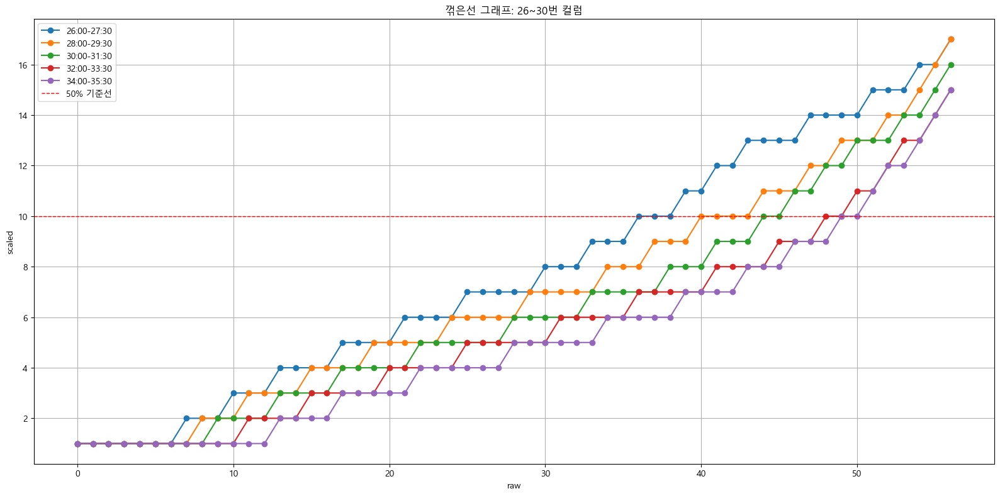

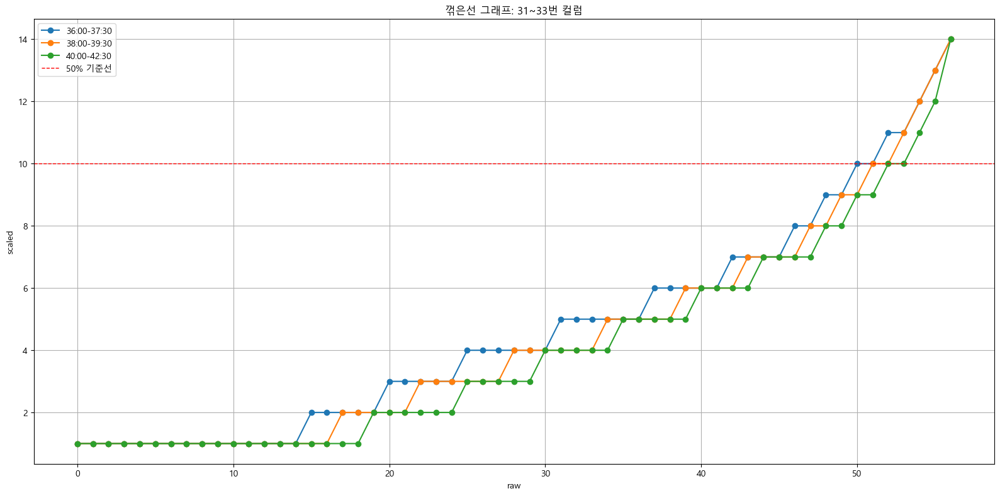

In [33]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 적응행동_개인자조 시각화

In [34]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='적응행동_개인자조(KPER)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:00-0:30 1:00-1:30 2:00-2:30 3:00-3:30 4:00-4:30 5:00-5:30  \
0              1         -         -         -         -         -         -   
1              2         -         -         -         -         -         -   
2              3         -         -         -         -         -         -   
3              4         -         -         -         -         -         -   
4              5         -         -         -         -         -         -   
5              6         -         -         -         -         -         0   
6              7         -         -         -         0         0         1   
7              8         -         -         -         -         1         2   
8              9         -         -         -         1         -         -   
9             10         0         0         0         -         2         3   
10            11         -         -         1         2         3         4   
11            12         1         1    

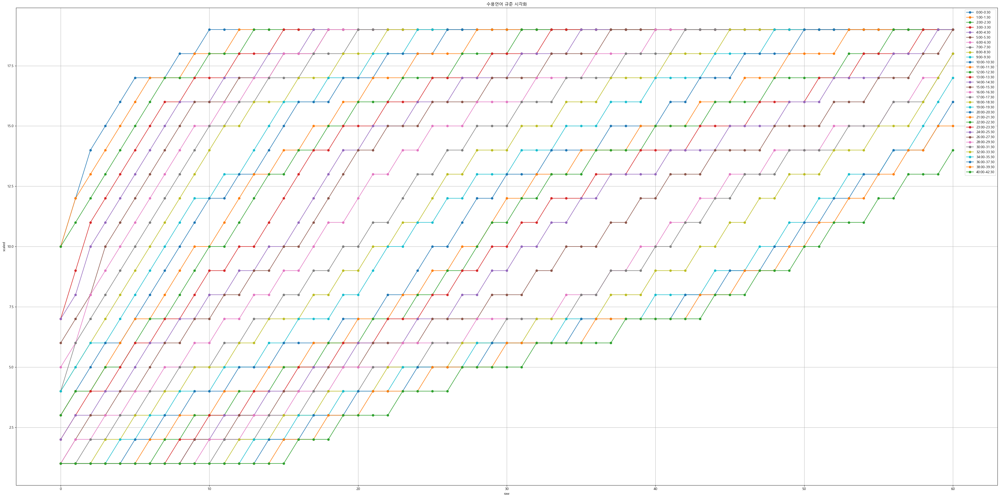

In [35]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

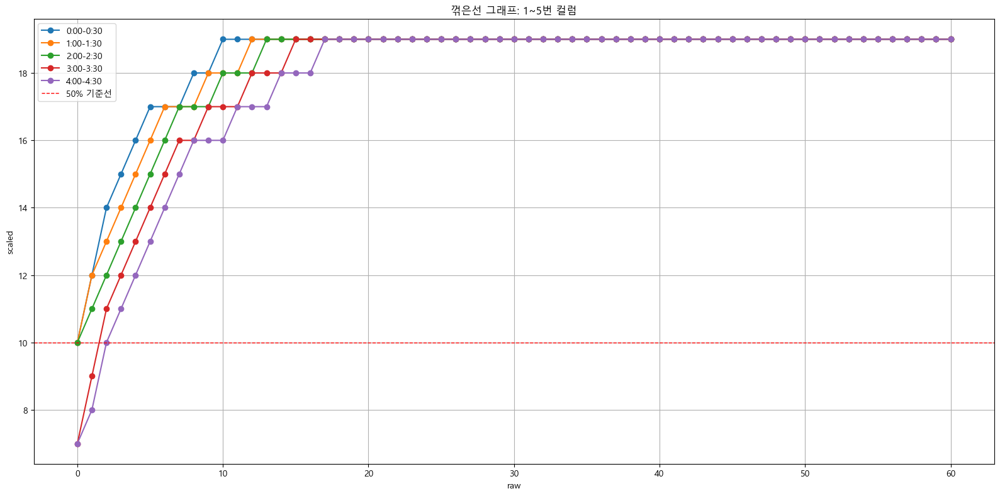

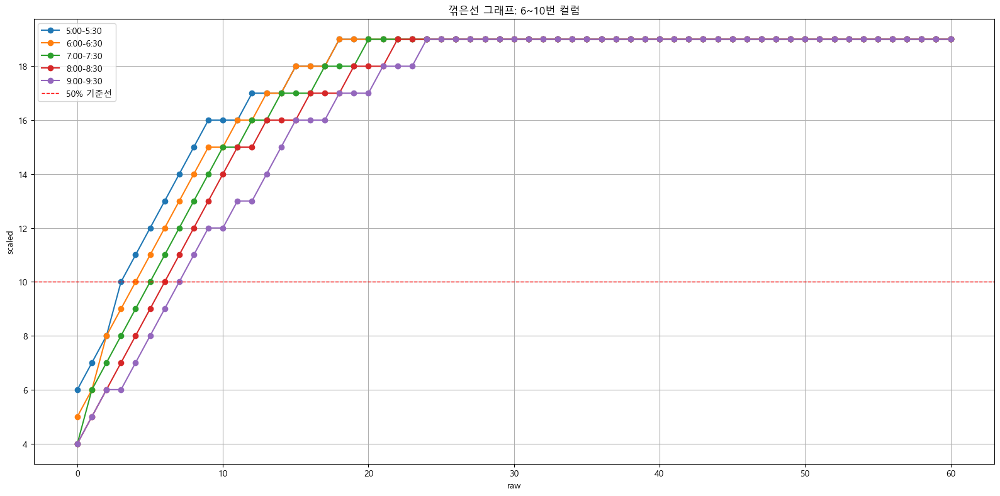

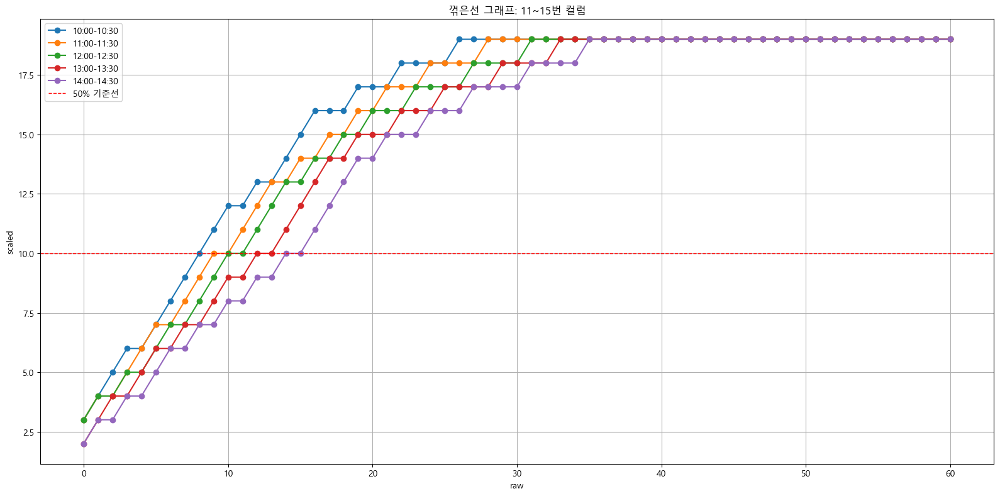

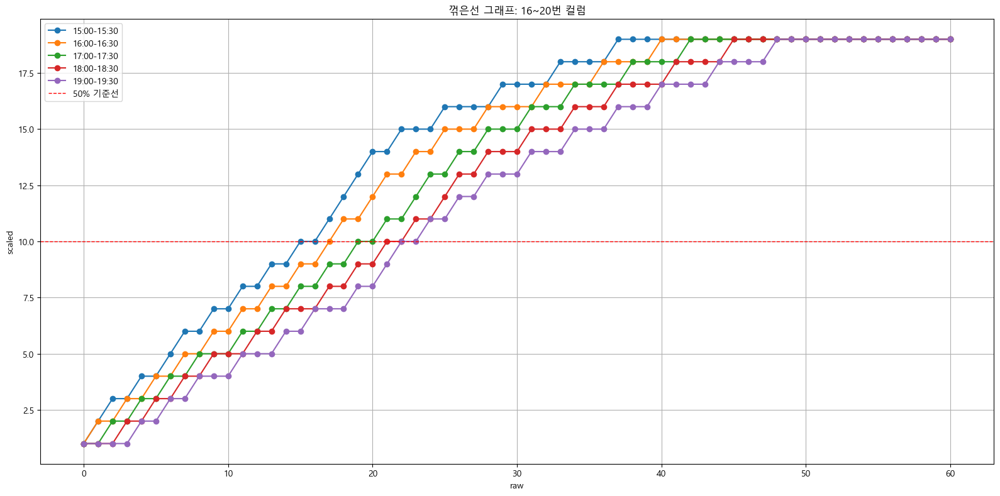

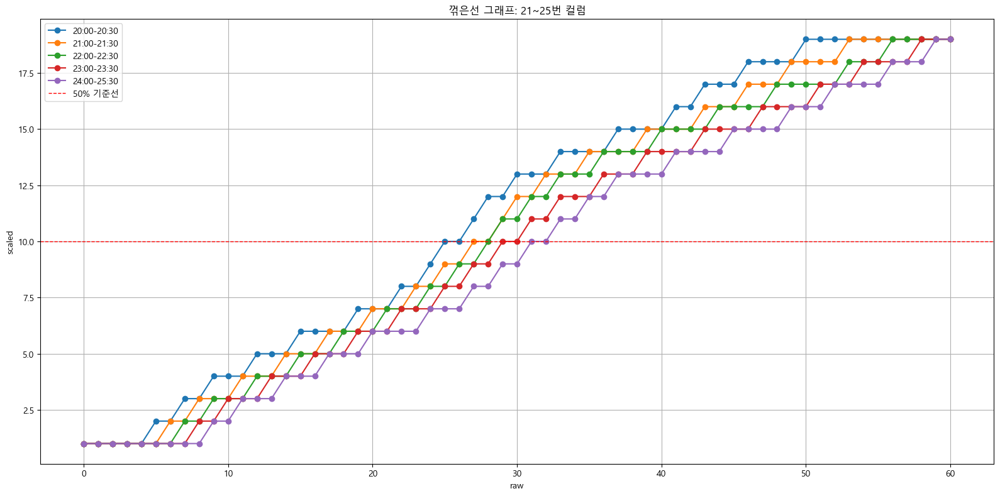

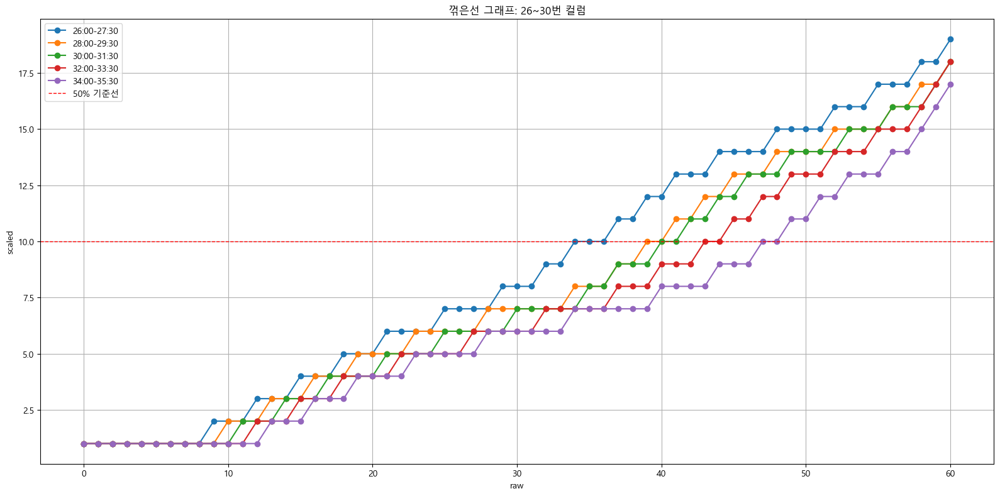

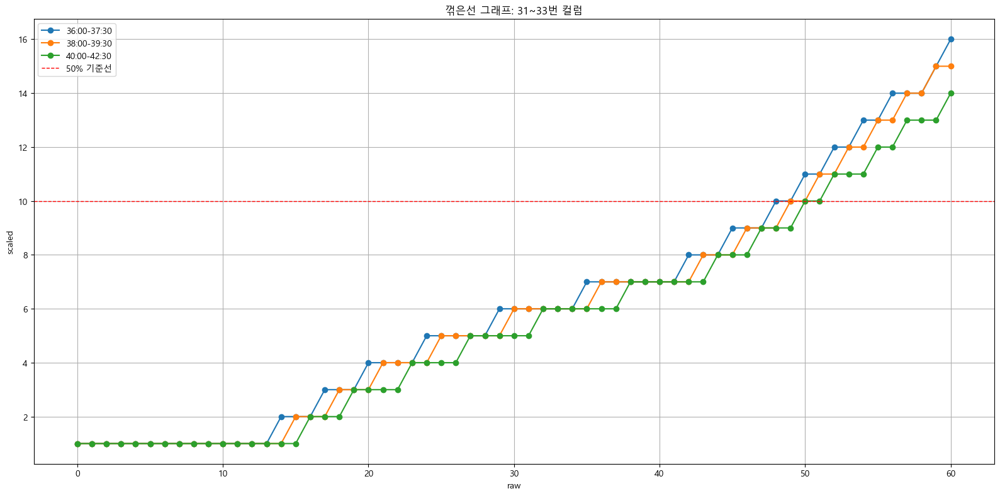

In [36]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 적응행동_대인관계 시각화

In [37]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='적응행동_대인관계(KIPR)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:00-0:30 1:00-1:30 2:00-2:30 3:00-3:30 4:00-4:30 5:00-5:30  \
0              1         -         -         -         -         0         0   
1              2         -         -         -         0         1         1   
2              3         -         0         0         1         2       2-3   
3              4         0         -         1         2         3         4   
4              5         -         1         2         3       4-5       5-6   
5              6         1         -         3       4-5       6-7       7-8   
6              7         -         2         4         6       8-9      9-10   
7              8         2         3         5         7        10        11   
8              9         -         4         6         8        11        12   
9             10         3         5         7         9        12     13-14   
10            11       4-5         6         8        10        13        15   
11            12         6         7    

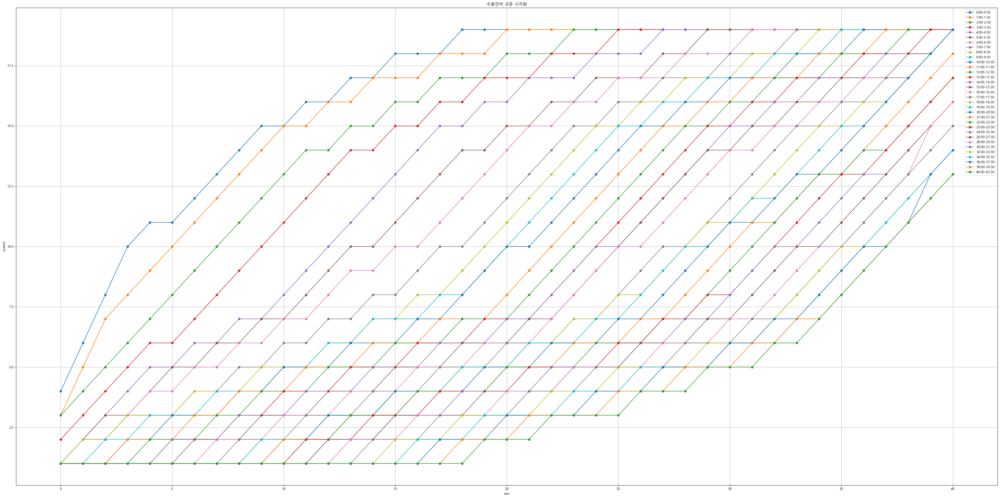

In [38]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

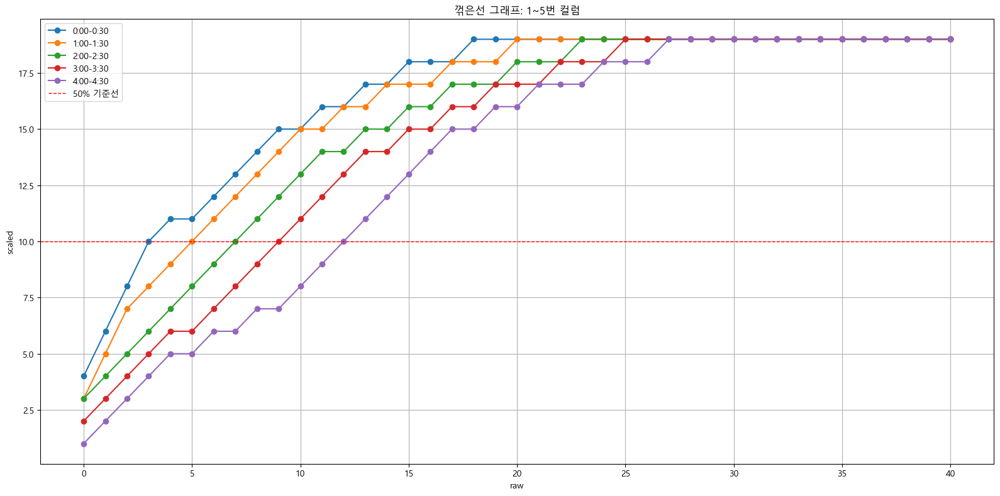

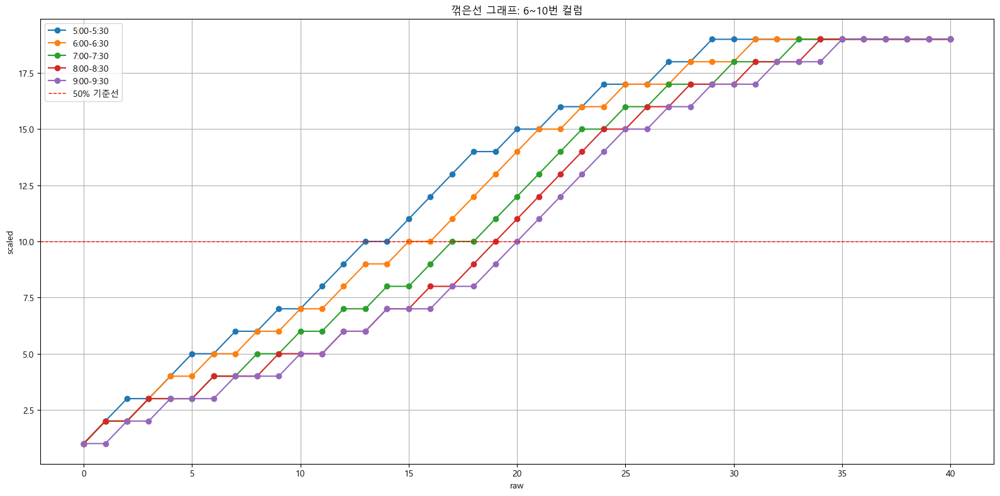

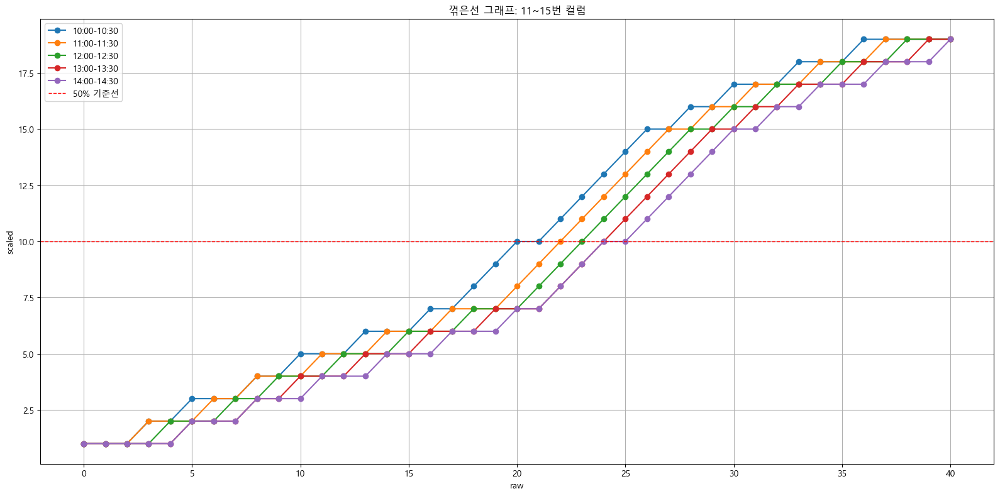

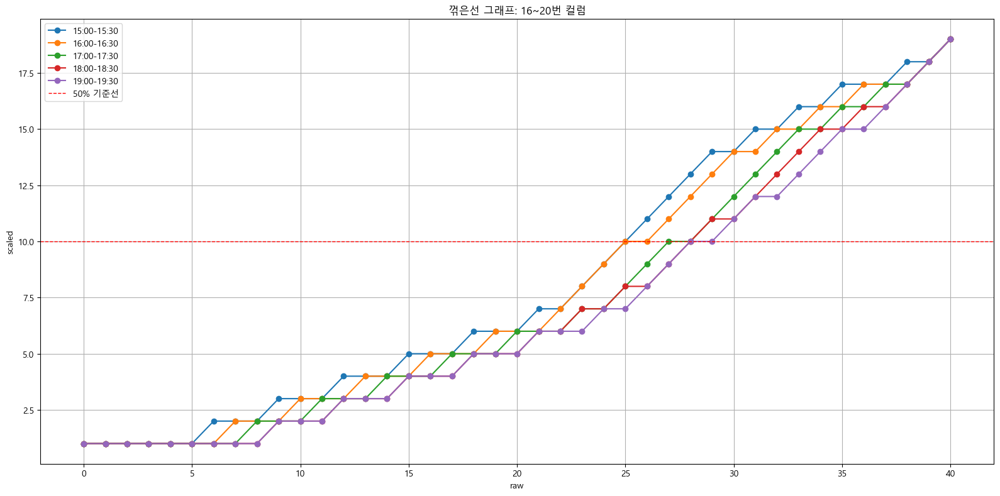

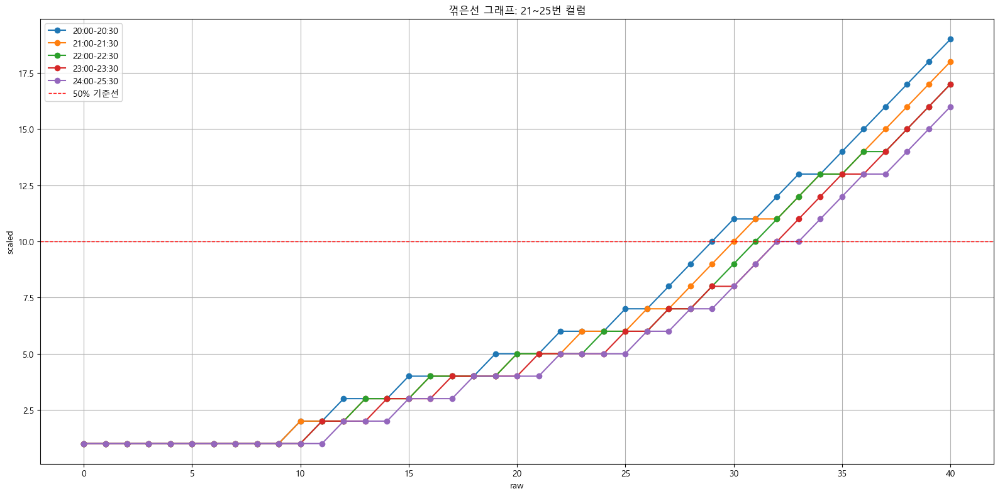

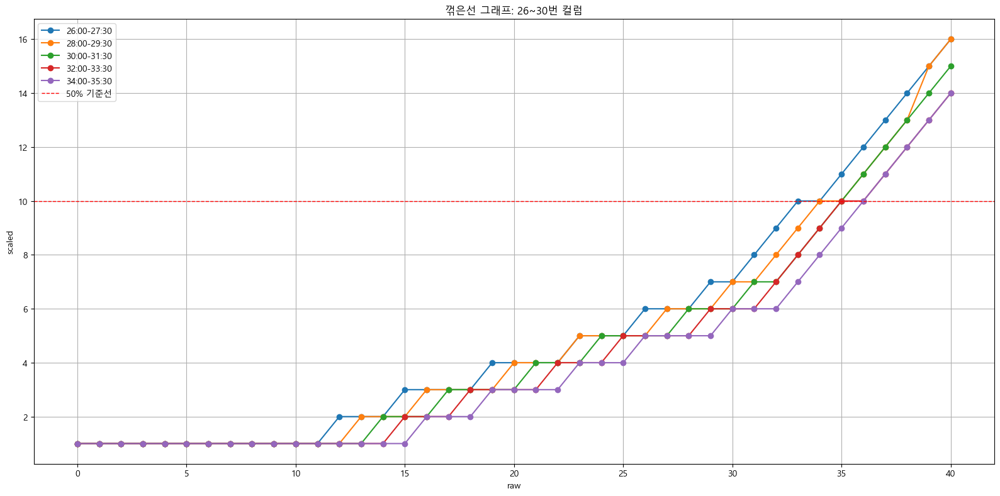

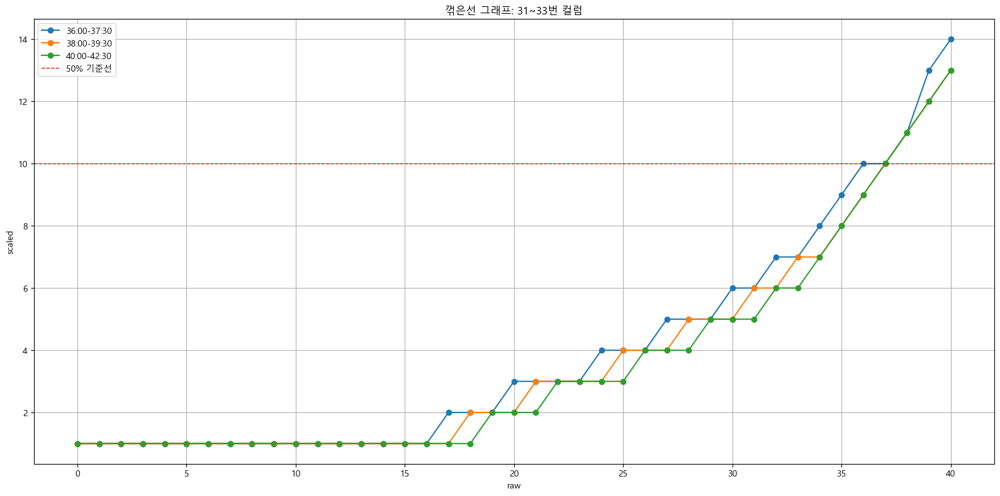

In [39]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### 적응행동_놀이&여가 시각화

In [40]:
# 척도별 원점수에 따른 단조 전처리
import pandas as pd

df = pd.read_excel('최종_규준(환산).xlsx', sheet_name='적응행동_놀이&여가(KIPR)')
print(df)

KRC = df
print(KRC.columns)
result_df = scale_score_df(KRC, raw_min=None, raw_max=None)

    scaled score 0:00-0:30 1:00-1:30 2:00-2:30 3:00-3:30 4:00-4:30 5:00-5:30  \
0              1         -         -         -         -         -         -   
1              2         -         -         -         -         -         0   
2              3         -         -         -         0         0         -   
3              4         -         -         0         -         1         1   
4              5         -         0         -         1         -         2   
5              6         -         -         1         -         2         -   
6              7         0         1         -         2         3         3   
7              8         -         -         2         -         -         4   
8              9         1         2         -         3         4         -   
9             10         -         -         3         4         -         5   
10            11         2         3         -         -         5         6   
11            12         -         -    

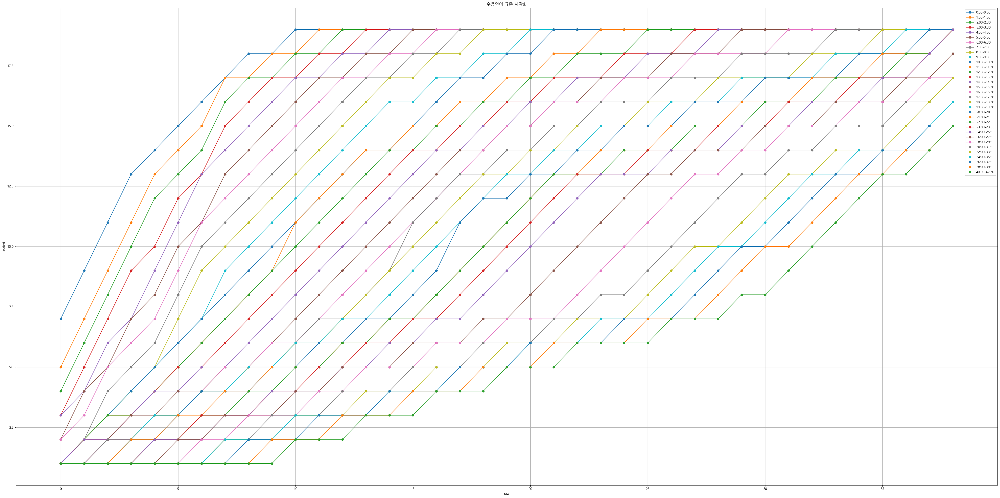

In [41]:
import matplotlib.pyplot as plt

# 꺾은선 그래프 시각화
plt.figure(figsize=(40, 20))
for col in result_df.columns[1:]:
    plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

plt.title('수용언어 규준 시각화')
plt.xlabel('raw')
plt.ylabel('scaled')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

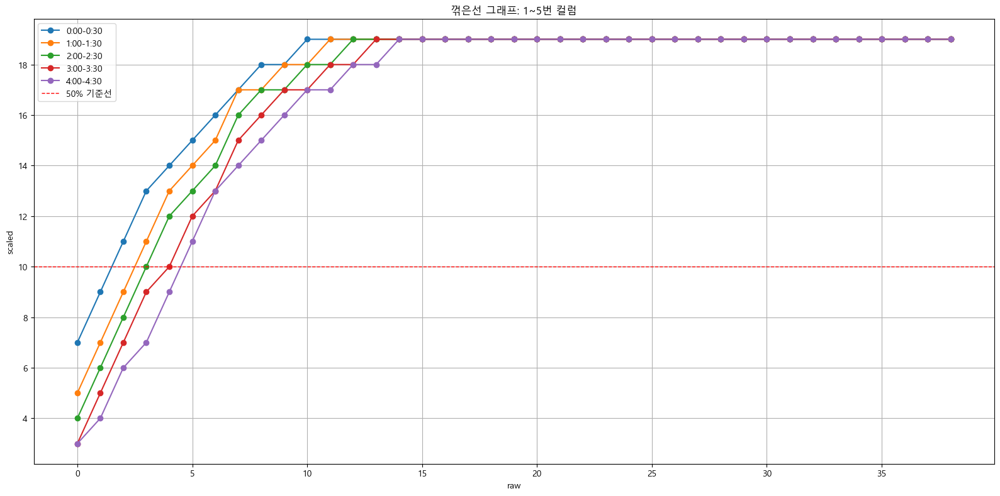

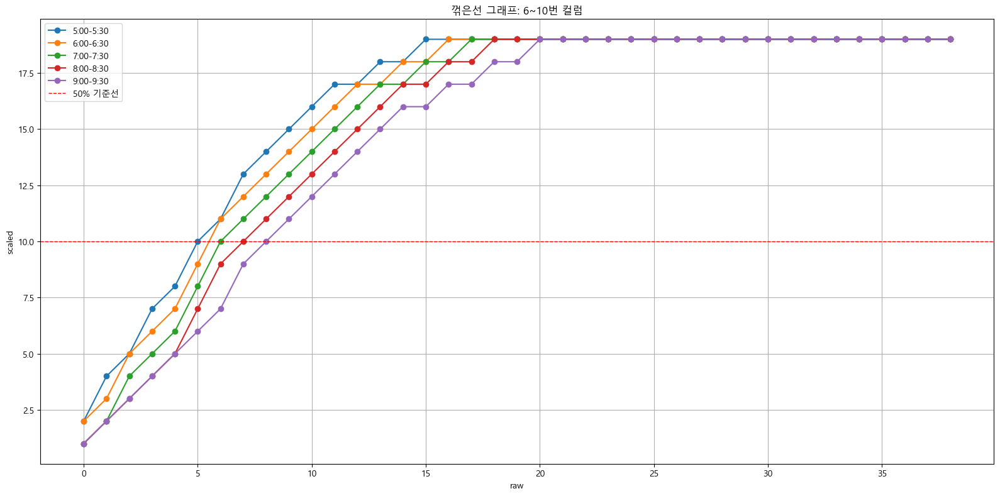

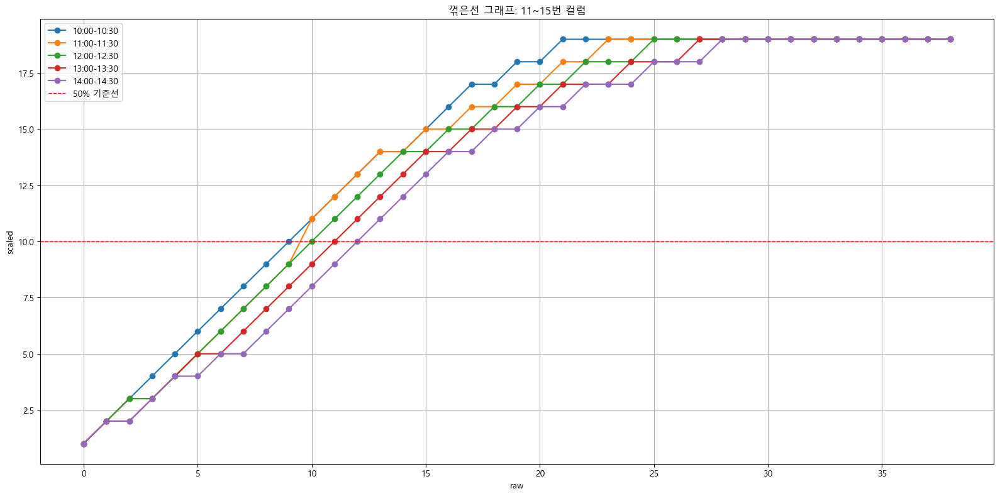

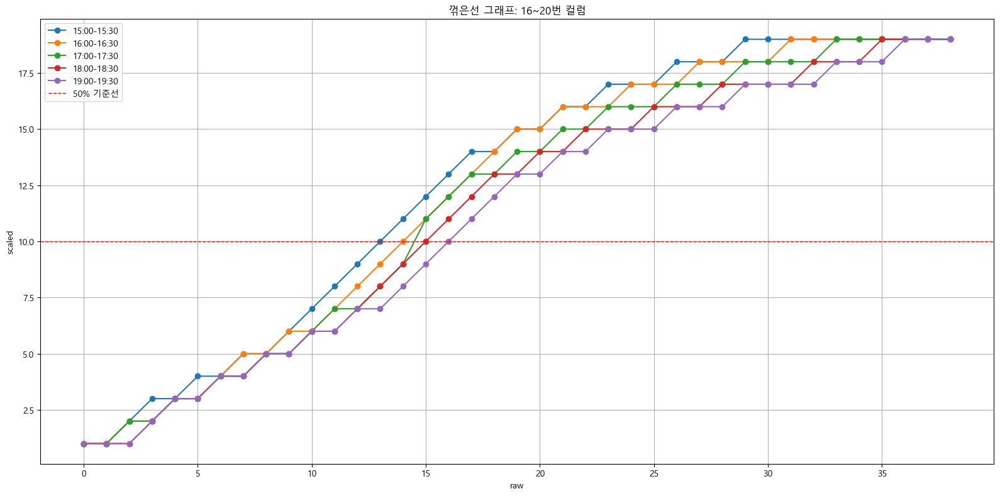

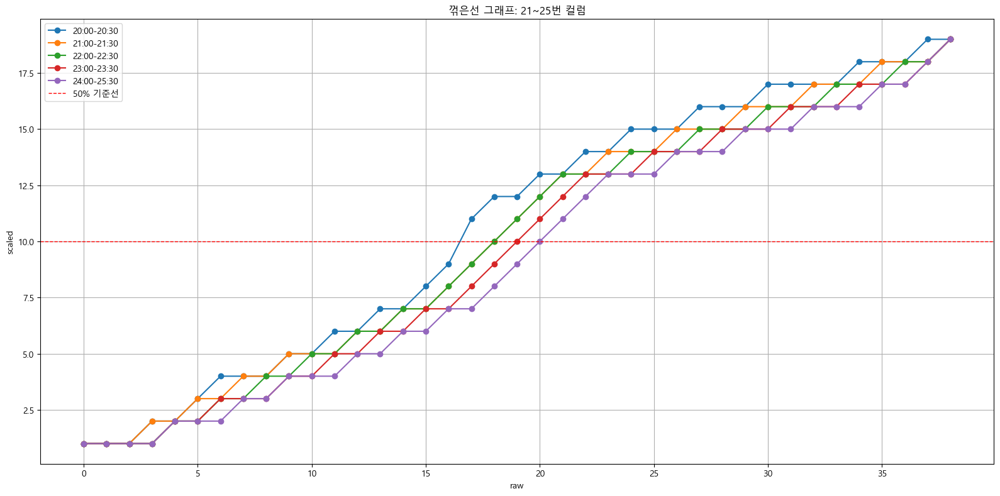

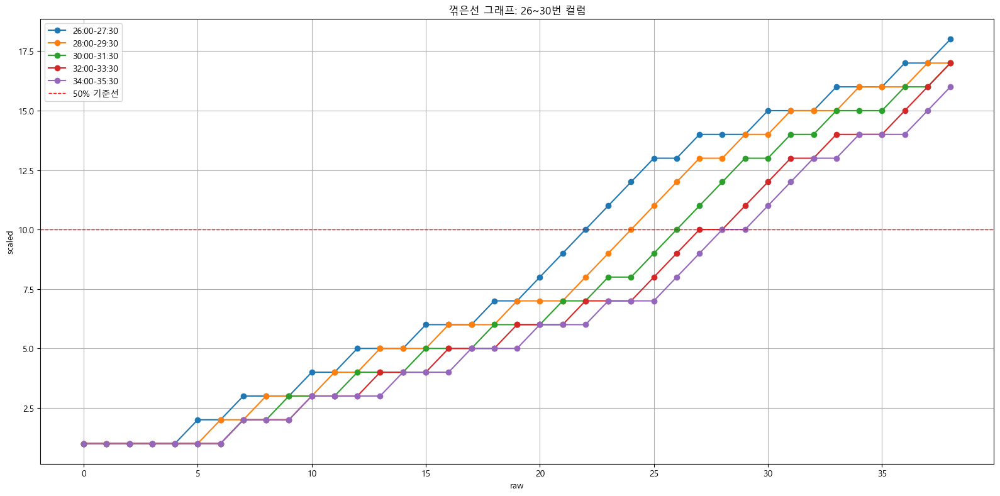

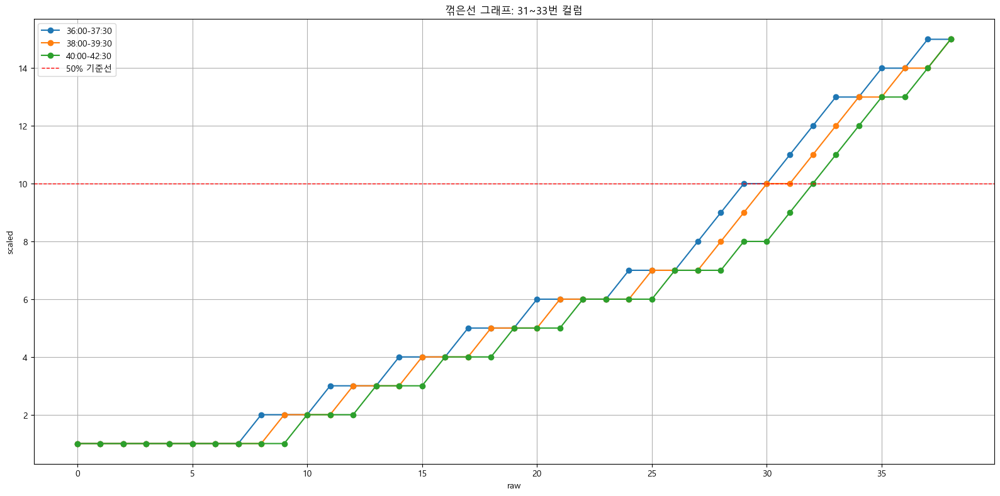

In [42]:
# raw 제외한 나머지 컬럼들만 추출
columns = result_df.columns[1:]
chunk_size = 5

# 컬럼을 5개씩 나눔
for i in range(0, len(columns), chunk_size):
    chunk = columns[i:i+chunk_size]

    # 그래프 생성
    plt.figure(figsize=(16, 8))
    for col in chunk:
        plt.plot(result_df['raw'], result_df[col], marker='o', label=col)

    plt.axhline(y=10, color='red', linestyle='--', linewidth=1, label='50% 기준선')

    plt.title(f'꺾은선 그래프: {i+1}~{i+len(chunk)}번 컬럼')
    plt.xlabel('raw')
    plt.ylabel('scaled')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()